<a href="https://colab.research.google.com/github/JoaoCioffi/Aero.py/blob/main/METAR/PredictiveSystem_Metar.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

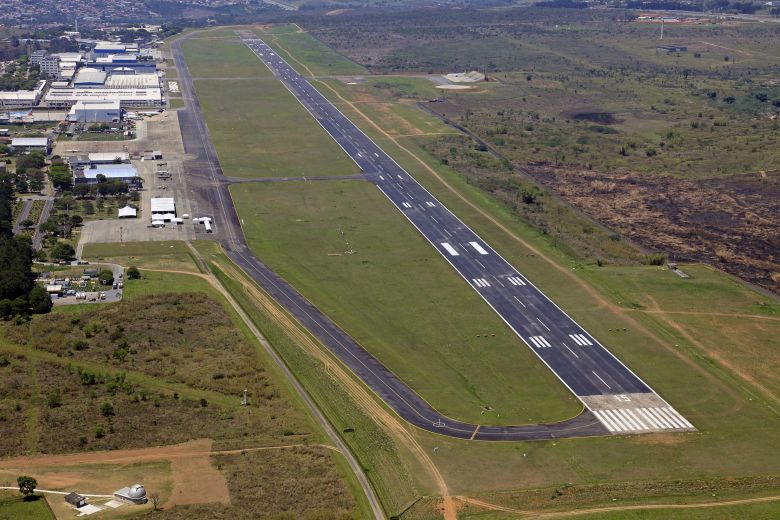

# Predictive System Using Metar Data (SBJS)

> **Main database:**  https://mesonet.agron.iastate.edu/request/download.phtml?network=BR__ASOS

The IEM maintains an ever growing archive of automated airport weather observations from around the world! These observations are typically called 'ASOS' or sometimes 'AWOS' sensors. A more generic term may be METAR data, which is a term that describes the format the data is transmitted as. This archive simply provides the as-is collection of historical observations, very little quality control is done. More details on this dataset are here: https://mesonet.agron.iastate.edu/info/datasets/metar.html

* **ASOS User's Guide:** https://www.weather.gov/media/asos/aum-toc.pdf

*  **Tools/Libaries:** Here (https://github.com/akrherz/iem/blob/main/scripts/asos/iem_scraper_example.py) is a python script example  that automates the download of data from this interface. A community user has contributed R language  version of the python script. There is also a riem R package  allowing for easy access to this archive.

> **Main Repository for this Project:**  https://github.com/JoaoCioffi/Aero.py/tree/main/METAR


## Main Libraries

In [254]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Numerical libraries
import pandas as pd
import numpy as np

# Visualization
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="ticks", color_codes=True)

# Statistics and Machine Learning
import statistics
from sklearn.model_selection import train_test_split
from sklearn import metrics

## Main Database: 2017-01-01 to 2021-12-31

### 1- Loading Data

---
> **Metadata:**
---
>> * **station:**
three or four character site identifier
* **valid:**
timestamp of the observation
* **tmpf:**
Air Temperature in Fahrenheit, typically @ 2 meters
* **dwpf:**
Dew Point Temperature in Fahrenheit, typically @ 2 meters
* **relh:**
Relative Humidity in %
* **drct:**
Wind Direction in degrees from *true* north
* **sknt:**
Wind Speed in knots
* **p01i:**
One hour precipitation for the period from the observation time to the time of the previous hourly precipitation reset. This varies slightly by site. Values are in inches. This value may or may not contain frozen precipitation melted by some device on the sensor or estimated by some other means. Unfortunately, we do not know of an authoritative database denoting which station has which sensor.
* **alti:**
Pressure altimeter in inches
* **mslp:**
Sea Level Pressure in millibar
* **vsby:**
Visibility in miles
* **gust:**
Wind Gust in knots
* **skyc1:**
Sky Level 1 Coverage
* **skyc2:**
Sky Level 2 Coverage
* **skyc3:**
Sky Level 3 Coverage
* **skyc4:**
Sky Level 4 Coverage
* **skyl1:**
Sky Level 1 Altitude in feet
* **skyl2:**
Sky Level 2 Altitude in feet
* **skyl3:**
Sky Level 3 Altitude in feet
* **skyl4:**
Sky Level 4 Altitude in feet
* **wxcodes:**
Present Weather Codes (space seperated)
* **feel:**
Apparent Temperature (Wind Chill or Heat Index) in Fahrenheit
* **ice_accretion_1hr:**
Ice Accretion over 1 Hour (inches)
* **ice_accretion_3hr:**
Ice Accretion over 3 Hours (inches)
* **ice_accretion_6hr:**
Ice Accretion over 6 Hours (inches)
* **peak_wind_gust:**
Peak Wind Gust (from PK WND METAR remark) (knots)
* **peak_wind_drct:**
Peak Wind Gust Direction (from PK WND METAR remark) (deg)
* **peak_wind_time:**
Peak Wind Gust Time (from PK WND METAR remark)
* **metar:**
unprocessed reported observation in METAR format

---
> **Obs:** for *Sky Coverage* values:
>> - **FEW**   -  few clouds
- **SCT**   - sparse
- **BKN**   - cloudy
- **OVC**   - overcast

---

#### (i) Raw Data

In [266]:
url = 'https://raw.githubusercontent.com/JoaoCioffi/Aero.py/main/METAR/Metar_SBSJ.csv'

df_raw = pd.read_csv(url)
df_raw

,station,valid,lon,lat,elevation,tmpf,dwpf,relh,drct,sknt,...,wxcodes,ice_accretion_1hr,ice_accretion_3hr,ice_accretion_6hr,peak_wind_gust,peak_wind_drct,peak_wind_time,feel,metar,snowdepth
0,SBSJ,2017-01-01 00:00,-45.8615,-23.2292,646.0,71.6,71.6,100.00,60.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,73.16,SBSJ 010000Z 06002KT 9999 FEW030 22/22 Q1017,NaN
1,SBSJ,2017-01-01 01:00,-45.8615,-23.2292,646.0,71.6,69.8,94.06,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,72.88,SBSJ 010100Z 00000KT 9999 FEW030 22/21 Q1017,NaN
2,SBSJ,2017-01-01 02:00,-45.8615,-23.2292,646.0,71.6,68.0,88.43,260.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,72.62,SBSJ 010200Z 26002KT 9999 FEW030 22/20 Q1018,NaN
3,SBSJ,2017-01-01 03:00,-45.8615,-23.2292,646.0,71.6,71.6,100.00,50.0,6.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,73.16,SBSJ 010300Z 05006KT 9999 FEW030 SCT040 22/22 ...,NaN
4,SBSJ,2017-01-01 04:00,-45.8615,-23.2292,646.0,71.6,69.8,94.06,60.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,72.88,SBSJ 010400Z 06005KT 9999 FEW030 22/21 Q1016,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40683,SBSJ,2021-12-30 20:00,-45.8615,-23.2292,646.0,69.8,66.2,88.34,130.0,8.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69.80,SBSJ 302000Z 13008KT 8000 SCT018 BKN027 BKN040...,NaN
40684,SBSJ,2021-12-30 21:00,-45.8615,-23.2292,646.0,69.8,64.4,82.98,130.0,9.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69.80,SBSJ 302100Z 13009KT 9999 SCT018 BKN033 OVC080...,NaN
40685,SBSJ,2021-12-30 21:45,-45.8615,-23.2292,646.0,69.8,64.4,82.98,120.0,8.0,...,-RA BR,NaN,NaN,NaN,NaN,NaN,NaN,69.80,SBSJ 302145Z 12008KT 4000 -RA BR SCT012 BKN025...,NaN
40686,SBSJ,2021-12-30 22:00,-45.8615,-23.2292,646.0,68.0,66.2,93.97,110.0,8.0,...,-RA BR,NaN,NaN,NaN,NaN,NaN,NaN,68.00,SBSJ 302200Z 11008KT 3000 -RA BR SCT012 BKN023...,NaN


In [256]:
df_raw.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40688 entries, 0 to 40687
Data columns (total 33 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   station            40688 non-null  object 
 1   valid              40688 non-null  object 
 2   lon                40688 non-null  float64
 3   lat                40688 non-null  float64
 4   elevation          40688 non-null  float64
 5   tmpf               40633 non-null  float64
 6   dwpf               40564 non-null  float64
 7   relh               40507 non-null  float64
 8   drct               39784 non-null  float64
 9   sknt               40677 non-null  float64
 10  p01i               40688 non-null  float64
 11  alti               40589 non-null  float64
 12  mslp               0 non-null      float64
 13  vsby               40677 non-null  float64
 14  gust               63 non-null     float64
 15  skyc1              33253 non-null  object 
 16  skyc2              119

#### (ii) Filtering by Important Features, Filling Missing Values and Changing DTypes

* **Selecting Features**

In [267]:
df = df_raw.drop(['station','elevation','lat',
                                'lon','mslp','gust','p01i',
                                'skyc2','skyl2','skyc3','skyl3','skyc4','skyl4','wxcodes',
                                'ice_accretion_1hr','ice_accretion_3hr','ice_accretion_6hr',
                                'peak_wind_gust','peak_wind_drct','peak_wind_time','snowdepth'],axis=1)
df

,valid,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,metar
0,2017-01-01 00:00,71.6,71.6,100.00,60.0,2.0,30.03,6.21,FEW,3000.0,73.16,SBSJ 010000Z 06002KT 9999 FEW030 22/22 Q1017
1,2017-01-01 01:00,71.6,69.8,94.06,0.0,0.0,30.03,6.21,FEW,3000.0,72.88,SBSJ 010100Z 00000KT 9999 FEW030 22/21 Q1017
2,2017-01-01 02:00,71.6,68.0,88.43,260.0,2.0,30.06,6.21,FEW,3000.0,72.62,SBSJ 010200Z 26002KT 9999 FEW030 22/20 Q1018
3,2017-01-01 03:00,71.6,71.6,100.00,50.0,6.0,30.03,6.21,FEW,3000.0,73.16,SBSJ 010300Z 05006KT 9999 FEW030 SCT040 22/22 ...
4,2017-01-01 04:00,71.6,69.8,94.06,60.0,5.0,30.00,6.21,FEW,3000.0,72.88,SBSJ 010400Z 06005KT 9999 FEW030 22/21 Q1016
...,...,...,...,...,...,...,...,...,...,...,...,...
40683,2021-12-30 20:00,69.8,66.2,88.34,130.0,8.0,29.85,4.97,SCT,1800.0,69.80,SBSJ 302000Z 13008KT 8000 SCT018 BKN027 BKN040...
40684,2021-12-30 21:00,69.8,64.4,82.98,130.0,9.0,29.85,6.21,SCT,1800.0,69.80,SBSJ 302100Z 13009KT 9999 SCT018 BKN033 OVC080...
40685,2021-12-30 21:45,69.8,64.4,82.98,120.0,8.0,29.88,2.49,SCT,1200.0,69.80,SBSJ 302145Z 12008KT 4000 -RA BR SCT012 BKN025...
40686,2021-12-30 22:00,68.0,66.2,93.97,110.0,8.0,29.88,1.86,SCT,1200.0,68.00,SBSJ 302200Z 11008KT 3000 -RA BR SCT012 BKN023...


* **Missing Values (NaN)**

In [268]:
pd.DataFrame({'Column Name':list(df.columns),
                            'Total of NaN':df.isna().sum().values,
                            'Percentage of NaN':[round((100*x/len(df)),3) for x in df.isna().sum().values]})

,Column Name,Total of NaN,Percentage of NaN
0,valid,0,0.000
1,tmpf,55,0.135
2,dwpf,124,0.305
3,relh,181,0.445
4,drct,904,2.222
5,sknt,11,0.027
6,alti,99,0.243
7,vsby,11,0.027
8,skyc1,7435,18.273
9,skyl1,8884,21.834


In [269]:
# Filling Missing Values --> https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.fillna.html
values = {'tmpf':df.tmpf.mean(),
          'dwpf':df.dwpf.mean(),
          'relh':df.relh.mean(),
          'drct':statistics.mode(df.drct),
          'sknt':df.sknt.mean(),
          'alti':df.alti.mean(),
          'vsby':df.vsby.mean(),
          'skyc1':statistics.mode(df.skyc1),
          'skyl1':statistics.mode(df.skyl1),
          'feel':df.feel.mean()
         }

df = df.fillna(value=values)

# Changing DType
df = df.astype({
    'valid':'datetime64[ns]',
    'skyc1':'category',
    'metar':'string'
})

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40688 entries, 0 to 40687
Data columns (total 12 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   valid   40688 non-null  datetime64[ns]
 1   tmpf    40688 non-null  float64       
 2   dwpf    40688 non-null  float64       
 3   relh    40688 non-null  float64       
 4   drct    40688 non-null  float64       
 5   sknt    40688 non-null  float64       
 6   alti    40688 non-null  float64       
 7   vsby    40688 non-null  float64       
 8   skyc1   40688 non-null  category      
 9   skyl1   40688 non-null  float64       
 10  feel    40688 non-null  float64       
 11  metar   40688 non-null  string        
dtypes: category(1), datetime64[ns](1), float64(9), string(1)
memory usage: 3.5 MB


### 2- Exploratory Data Analysis (EDA) and Feature Engineering

* **EDA**

#### (i) Data Distribution

In [270]:
round(df.describe(percentiles=[0.001,0.01,0.1,0.25,0.5,0.75,0.9,0.99,0.999]),3)

,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyl1,feel
count,40688.000,40688.000,40688.000,40688.000,40688.000,40688.000,40688.000,40688.000,40688.000
mean,69.943,60.048,73.916,138.335,4.355,29.979,5.528,2464.488,70.139
std,8.676,6.732,18.670,96.078,3.239,1.582,1.306,3617.464,8.937
min,32.000,12.200,9.040,0.000,0.000,0.270,0.030,100.000,24.110
0.1%,42.800,32.000,14.230,0.000,0.000,0.440,0.090,100.000,42.267
1%,50.000,41.000,24.303,0.000,0.000,29.800,1.240,300.000,50.000
10%,59.000,51.800,46.410,0.000,1.000,29.910,3.110,1000.000,59.000
25%,64.400,55.400,61.580,60.000,2.000,29.970,5.590,1700.000,64.400
50%,69.800,60.800,77.900,140.000,4.000,30.060,6.210,3000.000,69.800
75%,75.200,64.400,88.180,200.000,6.000,30.150,6.210,3000.000,75.200


#### (ii) Histogram and BoxPlot

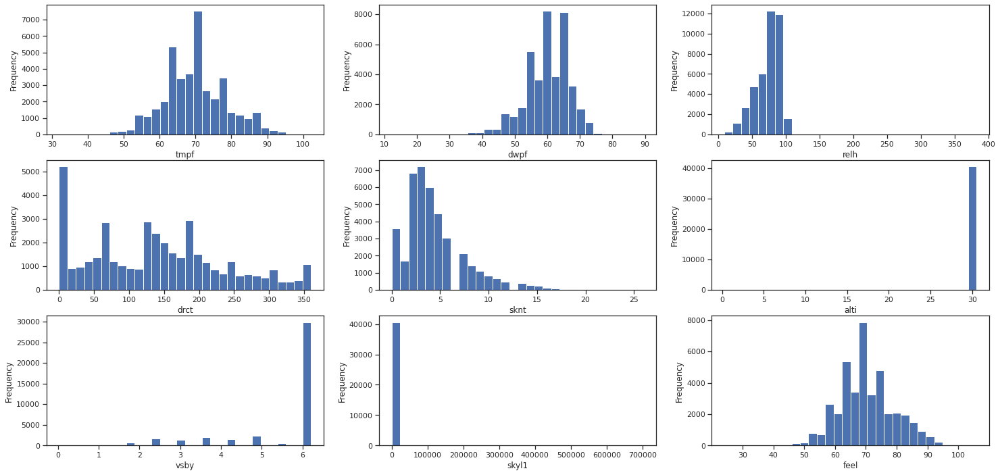

In [261]:
contColNames = list(df.select_dtypes(include='number').columns) #-> seleciona apenas colunas numéricas
ncols = 3 #-> número de colunas que armazenarão os plots na figura 
nrows = int(np.ceil(len(contColNames)/(1.0 * ncols))) #-> número de linhas que armazenarão os plots na figure 


fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(25,12))

counter = 0 

for i in range(nrows):
  for j in range(ncols):

    ax = axes[i][j]

    # Plotar somente quando houver dados
    if counter < len(contColNames):

      ax.hist(df.select_dtypes(include='number')[contColNames[counter]], bins=30)
      ax.set_xlabel(contColNames[counter])
      ax.set_ylabel('Frequency')

    else:
      ax.set_axis_off()

    counter += 1

plt.show()

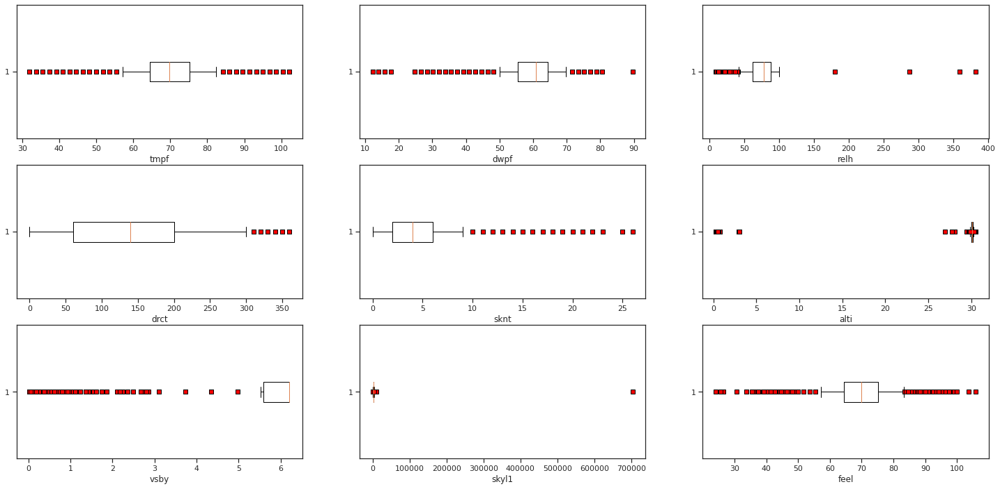

In [262]:
contColNames = list(df.select_dtypes(include='number').columns) #-> seleciona apenas colunas numéricas
ncols = 3 #-> número de colunas que armazenarão os plots na figure 
nrows = int(np.ceil(len(contColNames)/(1.0 * ncols))) #-> número de linhas que armazenarão os plots na figure 


fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(25,12))

counter = 0 

for i in range(nrows):
  for j in range(ncols):

    ax = axes[i][j]

    # Plotar somente quando houver dados
    if counter < len(contColNames):
      red_square = dict(markerfacecolor='red', marker='s')
      ax.boxplot(df.select_dtypes(include='number')[contColNames[counter]], flierprops=red_square, vert=False, whis=0.75)
      ax.set_xlabel(contColNames[counter])

    else:
      ax.set_axis_off()

    counter += 1
plt.show()

#### (iii) Removing Outliers: Interquartile Range (IQR) Analysis

****Obs: for numerical features only***

As we could see previously, there are some data distributions that are not coherent. There are some visible gaps and expressive outliers in our mass - for this reason we are going to treat these data via an IQR approach.

* **dwpf:** Dew Point Temperature in Fahrenheit

***Expected Range: [32.0~89.6] °F***

In [271]:
Q1 = df['dwpf'].quantile(0.25)
Q3 = df['dwpf'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR

print(df.dwpf.describe(percentiles=[0.01,0.1,0.25,0.5,0.75,0.9,0.99,0.999]),'\n\n')
print(f'Q1 = {round(Q1,3)}\nQ3 = {round(Q3,3)}\nIQR = {round(IQR,3)}')
print(f'Normal Range: ({round(lower_bound,3)} ~ {round(upper_bound,3)})')

count    40688.000000
mean        60.048299
std          6.731552
min         12.200000
1%          41.000000
10%         51.800000
25%         55.400000
50%         60.800000
75%         64.400000
90%         68.000000
99%         71.600000
99.9%       75.200000
max         89.600000
Name: dwpf, dtype: float64 


Q1 = 55.4
Q3 = 64.4
IQR = 9.0
Normal Range: (41.9 ~ 77.9)


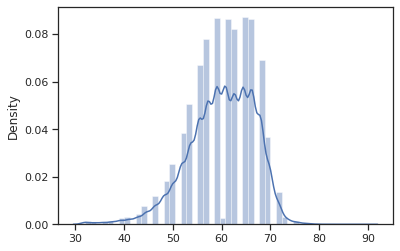

In [272]:
new_values = []
for val in df.dwpf.values:
  if val < 32.:
    new_values.append(32.)
  else:
    new_values.append(val)
  
sns.distplot(pd.DataFrame(new_values))

In [273]:
df.dwpf = new_values
df.dwpf.describe()

count    40688.000000
mean        60.053298
std          6.705969
min         32.000000
25%         55.400000
50%         60.800000
75%         64.400000
max         89.600000
Name: dwpf, dtype: float64

* **relh:** Relative Humidity in %

***Expected Range: [0~100] %***

In [274]:
Q1 = df['relh'].quantile(0.25)
Q3 = df['relh'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR

print(df.relh.describe(percentiles=[0.01,0.1,0.25,0.5,0.75,0.9,0.99,0.999]),'\n\n')
print(f'Q1 = {round(Q1,3)}\nQ3 = {round(Q3,3)}\nIQR = {round(IQR,3)}')
print(f'Normal Range: ({round(lower_bound,3)} ~ {round(upper_bound,3)})')

count    40688.000000
mean        73.916349
std         18.670060
min          9.040000
1%          24.303100
10%         46.410000
25%         61.580000
50%         77.900000
75%         88.180000
90%         93.920000
99%        100.000000
99.9%      100.000000
max        382.350000
Name: relh, dtype: float64 


Q1 = 61.58
Q3 = 88.18
IQR = 26.6
Normal Range: (21.68 ~ 128.08)


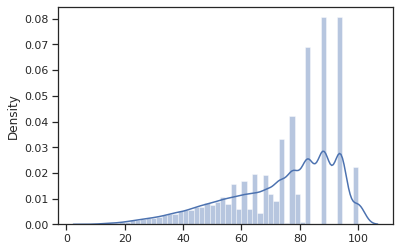

In [275]:
new_values = []
for val in df.relh.values:
  if val < 0:
    new_values.append(0)
  elif val > 100:
    new_values.append(100)
  else:
    new_values.append(val)
  
sns.distplot(pd.DataFrame(new_values))

In [276]:
df.relh = new_values
df.relh.describe()

count    40688.000000
mean        73.890099
std         18.463954
min          9.040000
25%         61.580000
50%         77.900000
75%         88.180000
max        100.000000
Name: relh, dtype: float64

* **alti:**

***Expected Range: [29.7~30.5] inches***
Pressure altimeter in inches

In [277]:
Q1 = df['alti'].quantile(0.25)
Q3 = df['alti'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR

print(df.alti.describe(percentiles=[0.01,0.1,0.25,0.5,0.75,0.9,0.99,0.999]),'\n\n')
print(f'Q1 = {round(Q1,3)}\nQ3 = {round(Q3,3)}\nIQR = {round(IQR,3)}')
print(f'Normal Range: ({round(lower_bound,3)} ~ {round(upper_bound,3)})')

count    40688.000000
mean        29.979231
std          1.582132
min          0.270000
1%          29.800000
10%         29.910000
25%         29.970000
50%         30.060000
75%         30.150000
90%         30.240000
99%         30.390000
99.9%       30.470000
max         30.500000
Name: alti, dtype: float64 


Q1 = 29.97
Q3 = 30.15
IQR = 0.18
Normal Range: (29.7 ~ 30.42)


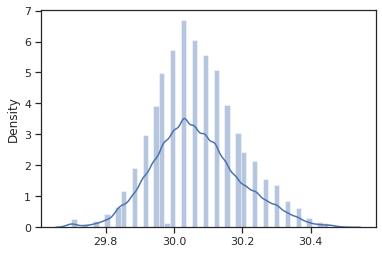

In [278]:
new_values = []
for val in df.alti.values:
  if val >= lower_bound:
    new_values.append(val)
  else:
    new_values.append(lower_bound)
  
sns.distplot(pd.DataFrame(new_values))

In [279]:
df.alti = new_values
df.alti.describe()

count    40688.000000
mean        30.065018
std          0.126635
min         29.700000
25%         29.970000
50%         30.060000
75%         30.150000
max         30.500000
Name: alti, dtype: float64

* **skyl1:**
Sky Level 1 Altitude in feet

***Expected Range: [100.0~4950.0] ft***

In [280]:
Q1 = df['skyl1'].quantile(0.25)
Q3 = df['skyl1'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5*IQR
upper_bound = Q3 + 1.5*IQR

print(df.skyl1.describe(percentiles=[0.01,0.1,0.25,0.5,0.75,0.9,0.99,0.999]),'\n\n')
print(f'Q1 = {round(Q1,3)}\nQ3 = {round(Q3,3)}\nIQR = {round(IQR,3)}')
print(f'Normal Range: ({round(lower_bound,3)} ~ {round(upper_bound,3)})')

count     40688.000000
mean       2464.488301
std        3617.464116
min         100.000000
1%          300.000000
10%        1000.000000
25%        1700.000000
50%        3000.000000
75%        3000.000000
90%        4000.000000
99%        4500.000000
99.9%      4900.000000
max      703000.000000
Name: skyl1, dtype: float64 


Q1 = 1700.0
Q3 = 3000.0
IQR = 1300.0
Normal Range: (-250.0 ~ 4950.0)


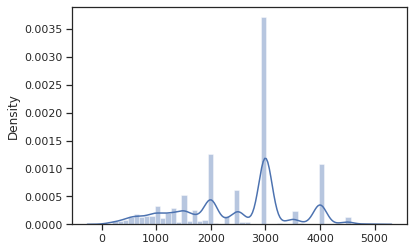

In [281]:
new_values = []
for val in df.skyl1.values:
  if val > upper_bound:
    new_values.append(upper_bound)
  else:
    new_values.append(val)
  
sns.distplot(pd.DataFrame(new_values))

In [282]:
df.skyl1 = new_values
df.skyl1.describe()

count    40688.000000
mean      2447.128146
std       1011.203942
min        100.000000
25%       1700.000000
50%       3000.000000
75%       3000.000000
max       4950.000000
Name: skyl1, dtype: float64

#### (iv) Feature Engineering

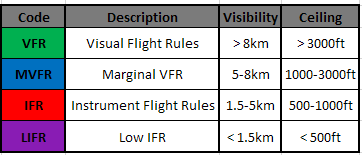

**Flight category definitions:** https://www.aviationweather.gov/taf/help?page=plot

In [283]:
# Remembering our dataset
df.head()

,valid,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,metar
0,2017-01-01 00:00:00,71.6,71.6,100.00,60.0,2.0,30.03,6.21,FEW,3000.0,73.16,SBSJ 010000Z 06002KT 9999 FEW030 22/22 Q1017
1,2017-01-01 01:00:00,71.6,69.8,94.06,0.0,0.0,30.03,6.21,FEW,3000.0,72.88,SBSJ 010100Z 00000KT 9999 FEW030 22/21 Q1017
2,2017-01-01 02:00:00,71.6,68.0,88.43,260.0,2.0,30.06,6.21,FEW,3000.0,72.62,SBSJ 010200Z 26002KT 9999 FEW030 22/20 Q1018
3,2017-01-01 03:00:00,71.6,71.6,100.00,50.0,6.0,30.03,6.21,FEW,3000.0,73.16,SBSJ 010300Z 05006KT 9999 FEW030 SCT040 22/22 ...
4,2017-01-01 04:00:00,71.6,69.8,94.06,60.0,5.0,30.00,6.21,FEW,3000.0,72.88,SBSJ 010400Z 06005KT 9999 FEW030 22/21 Q1016


* **Creating new features**

In [284]:
# 1- Time Series Decomposition:
df['year'] = df.valid.dt.year.values
df['month'] = df.valid.dt.month.values
df['dayofweek_flag'] = df.valid.dt.day_of_week.values #-> from 0 (sundays) to 7 (saturdays) 
df['day'] = df.valid.dt.day.values
df['hour'] = df.valid.dt.hour
df['min'] = df.valid.dt.minute

season_flag = []
for m in df.month:
  if m in (12,1,2):
    season_flag.append('summer')
  elif m in (3,4,5):
    season_flag.append('autumn')
  elif m in (6,7,8):
    season_flag.append('winter')
  else:
    season_flag.append('spring')
df['season_flag'] = season_flag


# 2- Flight Rules Code:
fr_code =[]
for v, slv in zip(df.vsby.values, df.skyl1.values):
  if (v > 5.) and (slv > 3e+03): # VFR: visibility > 5 miles and ceiling > 3000ft
    fr_code.append('VFR')
  elif (3. < v <= 5.) or (1e+03 < slv <= 3e+03): # MVFR: visibility between 3 and 5 miles and/or ceiling between 1000ft and 3000ft
    fr_code.append('MVFR')
  elif (1. < v <= 3.) or (5e+02 < slv <= 1e+03): # IFR: visibility between 1 and 3 miles and/or ceiling between 1000ft and 3000ft
    fr_code.append('IFR')
  elif (v <= 1.) or (slv <= 5e+02): # LIFR: visibility less than 1 mile and/or ceiling below 500ft
    fr_code.append('LIFR')
df['fr_code'] = fr_code

# Changimg DTypes
df = df.astype({
    'year':'int32',
    'month':'int32',
    'dayofweek_flag':'int32',
    'day':'int32',
    'season_flag':'category',
    'fr_code':'category'
})


df # checking for updates

,valid,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,metar,year,month,dayofweek_flag,day,hour,min,season_flag,fr_code
0,2017-01-01 00:00:00,71.6,71.6,100.00,60.0,2.0,30.03,6.21,FEW,3000.0,73.16,SBSJ 010000Z 06002KT 9999 FEW030 22/22 Q1017,2017,1,6,1,0,0,summer,MVFR
1,2017-01-01 01:00:00,71.6,69.8,94.06,0.0,0.0,30.03,6.21,FEW,3000.0,72.88,SBSJ 010100Z 00000KT 9999 FEW030 22/21 Q1017,2017,1,6,1,1,0,summer,MVFR
2,2017-01-01 02:00:00,71.6,68.0,88.43,260.0,2.0,30.06,6.21,FEW,3000.0,72.62,SBSJ 010200Z 26002KT 9999 FEW030 22/20 Q1018,2017,1,6,1,2,0,summer,MVFR
3,2017-01-01 03:00:00,71.6,71.6,100.00,50.0,6.0,30.03,6.21,FEW,3000.0,73.16,SBSJ 010300Z 05006KT 9999 FEW030 SCT040 22/22 ...,2017,1,6,1,3,0,summer,MVFR
4,2017-01-01 04:00:00,71.6,69.8,94.06,60.0,5.0,30.00,6.21,FEW,3000.0,72.88,SBSJ 010400Z 06005KT 9999 FEW030 22/21 Q1016,2017,1,6,1,4,0,summer,MVFR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40683,2021-12-30 20:00:00,69.8,66.2,88.34,130.0,8.0,29.85,4.97,SCT,1800.0,69.80,SBSJ 302000Z 13008KT 8000 SCT018 BKN027 BKN040...,2021,12,3,30,20,0,summer,MVFR
40684,2021-12-30 21:00:00,69.8,64.4,82.98,130.0,9.0,29.85,6.21,SCT,1800.0,69.80,SBSJ 302100Z 13009KT 9999 SCT018 BKN033 OVC080...,2021,12,3,30,21,0,summer,MVFR
40685,2021-12-30 21:45:00,69.8,64.4,82.98,120.0,8.0,29.88,2.49,SCT,1200.0,69.80,SBSJ 302145Z 12008KT 4000 -RA BR SCT012 BKN025...,2021,12,3,30,21,45,summer,MVFR
40686,2021-12-30 22:00:00,68.0,66.2,93.97,110.0,8.0,29.88,1.86,SCT,1200.0,68.00,SBSJ 302200Z 11008KT 3000 -RA BR SCT012 BKN023...,2021,12,3,30,22,0,summer,MVFR


#### (v) Correlation Matrix (Pearson's) and KDE Plot

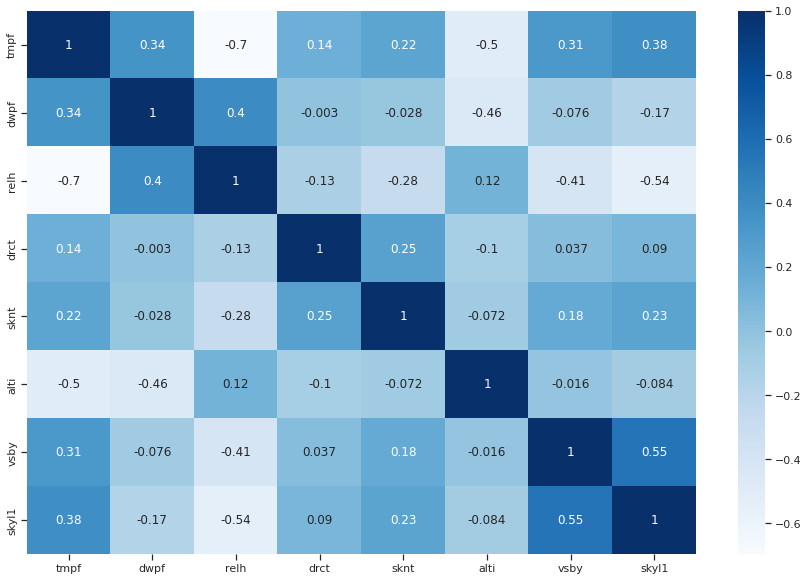

In [285]:
plt.figure(figsize=(15,10))
sns.heatmap(df[['tmpf', 'dwpf', 'relh', 'drct',
                               'sknt','alti','vsby','skyl1']].corr(), annot=True, cmap='Blues')

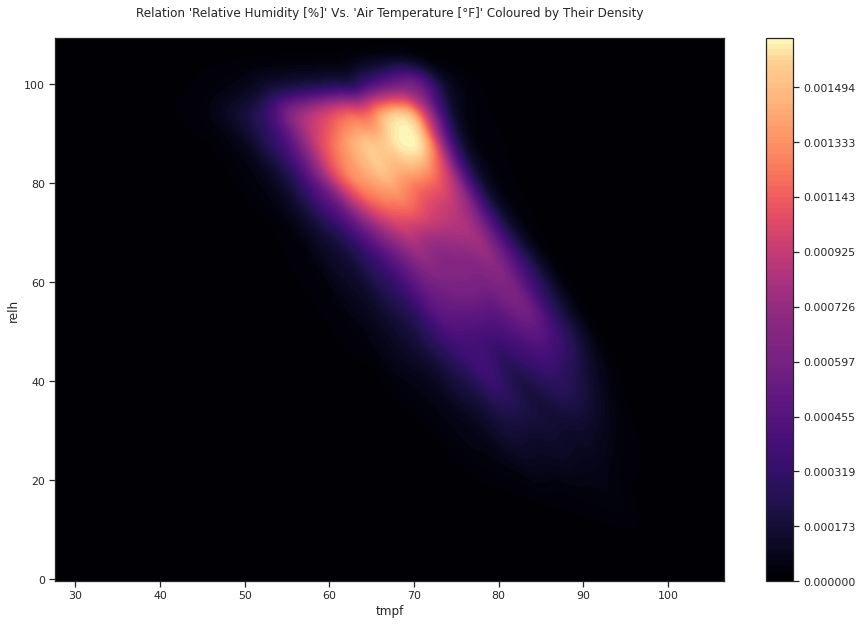

In [ ]:
fig, axs = plt.subplots(figsize=(15,10))
plt.title("Relation 'Relative Humidity [%]' Vs. 'Air Temperature [°F]' Coloured by Their Density\n")
sns.kdeplot(
    data=df, x="tmpf", y="relh",
    fill=True, thresh=0, levels=100, cmap="magma", cbar = True)

#https://seaborn.pydata.org/generated/seaborn.kdeplot.html

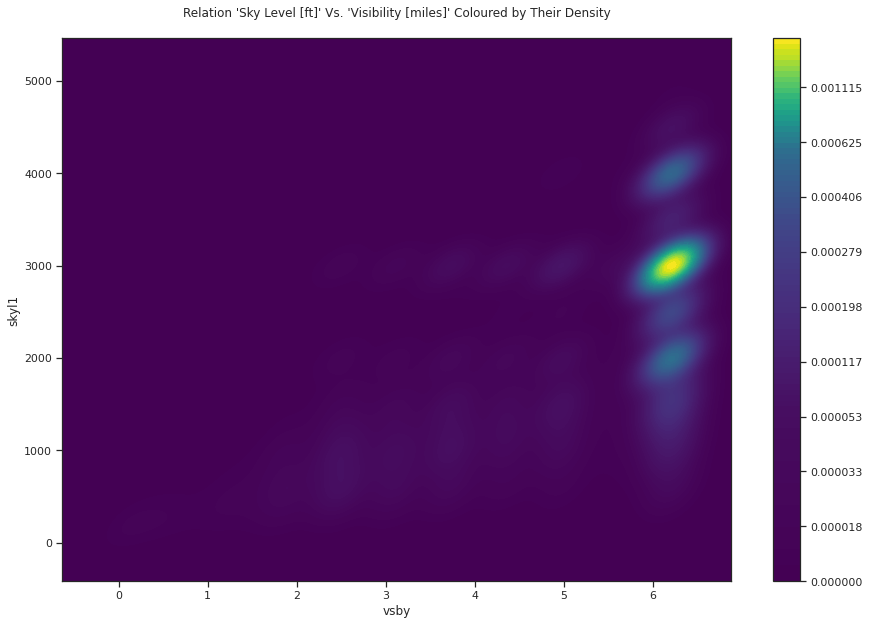

In [ ]:
fig, axs = plt.subplots(figsize=(15,10))
plt.title("Relation 'Sky Level [ft]' Vs. 'Visibility [miles]' Coloured by Their Density\n")
sns.kdeplot(
    data=df, x="vsby", y="skyl1",
    fill=True, thresh=0, levels=100, cmap="viridis", cbar = True)

#https://seaborn.pydata.org/generated/seaborn.kdeplot.html

#### (vi) Pairplot colored by Flight Rule Code

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


<Figure size 2160x1800 with 0 Axes>

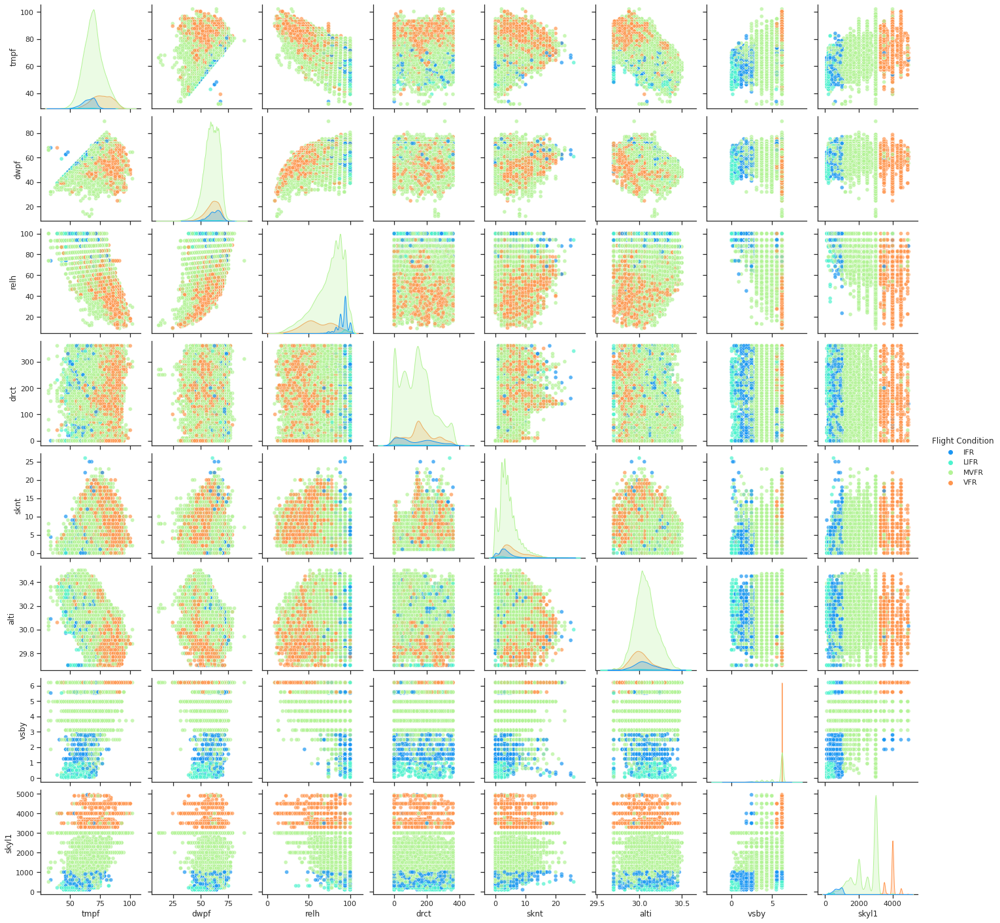

In [ ]:
# Will only use six variables for plotting pairs
reduced_features = df[['tmpf', 'dwpf', 'relh', 'drct','sknt','alti','vsby','skyl1']]
cod = df.fr_code.values
reduced_features['Flight Condition'] = cod


# Make the pair plot with a some aesthetic changes
plt.figure(figsize=(30,25))
sns.pairplot(reduced_features, hue = 'Flight Condition', diag_kind = 'kde', palette='rainbow', plot_kws=dict(alpha = 0.7),
                   diag_kws=dict(shade=True))

#### (vii) Quantitative Analysis

* **Sky Level 1 Coverage**

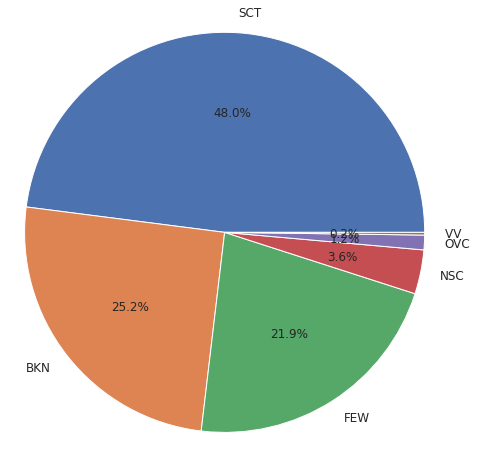

In [ ]:
plt.figure(figsize=(10,8))
plt.pie(df.skyc1.value_counts(), labels = list(df.skyc1.value_counts().index), autopct='%1.1f%%', radius = 1.15, textprops = {"fontsize" : 12}) 
plt.show()

* **Flight Rules Code**

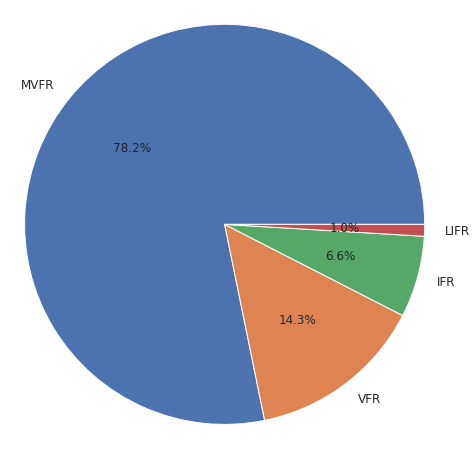

In [ ]:
plt.figure(figsize=(10,8))
plt.pie(df.fr_code.value_counts(), labels = list(df.fr_code.value_counts().index), autopct='%1.1f%%', radius = 1.15, textprops = {"fontsize" : 12}) 
plt.show()

#### (viii) Aggregated Analysis

* **by Year**

In [ ]:
df_agg_year = df[['year','tmpf', 'dwpf', 'relh', 'drct','sknt','alti','vsby','skyl1']].groupby(by='year').agg(['min','mean','max'])
df_agg_year

tmpf                    dwpf                    relh                    \
       min       mean    max   min       mean   max    min       mean    max   
year                                                                           
2017  46.4  69.426351  100.4  33.8  60.385175  80.6  14.23  75.900099  100.0   
2018  32.0  69.729288  102.2  35.6  61.329499  73.4  21.04  76.946563  100.0   
2019  32.0  70.370112   96.8  32.0  61.377652  75.2  11.04  76.092067  100.0   
2020  42.8  71.057228  102.2  32.0  58.948933  89.6   9.04  69.106030  100.0   
2021  33.8  69.154467   95.0  32.0  57.628301  73.4  12.06  70.006528  100.0   

     drct  ...  sknt  alti                    vsby                  skyl1  \
      min  ...   max   min       mean    max   min      mean   max    min   
year       ...                                                              
2017  0.0  ...  23.0  29.7  30.077194  30.50  0.06  5.550473  6.21  100.0   
2018  0.0  ...  23.0  29.7  30.059859  30.39  0.06  5.520349  6.21  100.0   
2019  0.0  ...  25.0  29.7  30.067614  30.47  0.06  5.516401  6.21  100.0   
2020  0.0  ...  22.0  29.7  30.060357  30.45  0.03  5.586040  6.21  100.0   
2021  0.0  ...  26.0  29.7  30.058252  30.47  0.03  5.463620  6.21  100.0   

                           
             mean     max  
year                       
2017  2267.501156  4950.0  
2018  2356.471601  4950.0  
2019  2483.685835  4900.0  
2020  2627.783032  4950.0  
2021  2542.795429  4950.0  

[5 rows x 24 columns]

([<matplotlib.axis.XTick at 0x7fa704be0850>,
 <a list of 5 Text major ticklabel objects>)

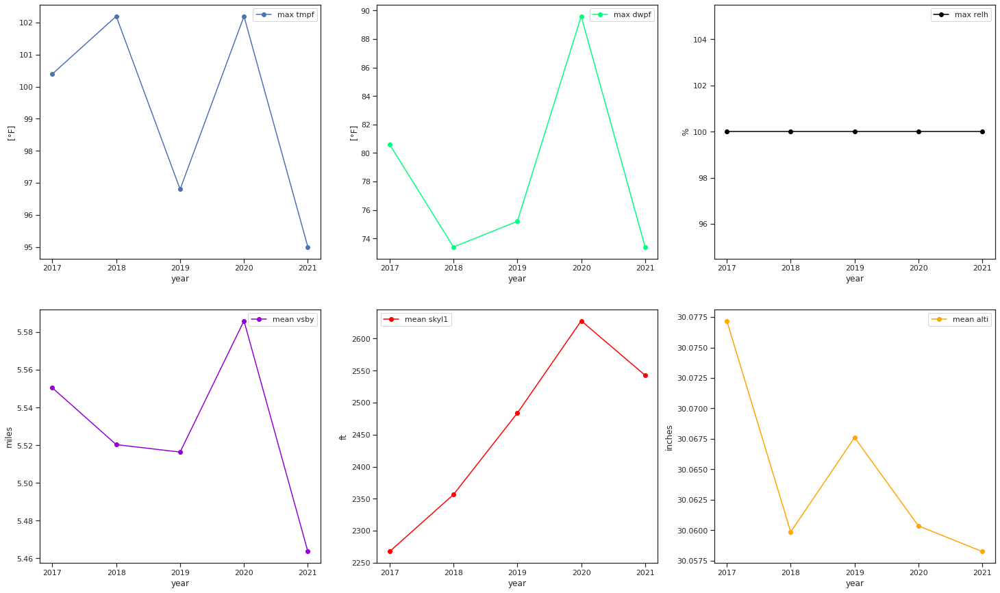

In [ ]:
plt.figure(figsize=(25,15))

# matplotlib colors: https://matplotlib.org/3.5.0/_images/sphx_glr_named_colors_003.png

plt.subplot(2, 3, 1)
plt.plot(df_agg_year.index.values, df_agg_year.tmpf['max'],'-o',color='b')
plt.xlabel('year')
plt.ylabel('[°F]')
plt.legend(['max tmpf'],loc='best')
plt.xticks(ticks=df_agg_year.index.values)

plt.subplot(2, 3, 2)
plt.plot(df_agg_year.index.values, df_agg_year.dwpf['max'],'-o',color='springgreen')
plt.xlabel('year')
plt.ylabel('[°F]')
plt.legend(['max dwpf'],loc='best')
plt.xticks(ticks=df_agg_year.index.values)

plt.subplot(2, 3, 3)
plt.plot(df_agg_year.index.values, df_agg_year.relh['max'],'-o',color='black')
plt.xlabel('year')
plt.ylabel('%')
plt.legend(['max relh'],loc='best')
plt.xticks(ticks=df_agg_year.index.values)

plt.subplot(2, 3, 4)
plt.plot(df_agg_year.index.values, df_agg_year.vsby['mean'],'-o',color='darkviolet')
plt.xlabel('year')
plt.ylabel('miles')
plt.legend(['mean vsby'],loc='best')
plt.xticks(ticks=df_agg_year.index.values)

plt.subplot(2, 3, 5)
plt.plot(df_agg_year.index.values, df_agg_year.skyl1['mean'],'-o',color='red')
plt.xlabel('year')
plt.ylabel('ft')
plt.legend(['mean skyl1'],loc='best')
plt.xticks(ticks=df_agg_year.index.values)

plt.subplot(2, 3, 6)
plt.plot(df_agg_year.index.values, df_agg_year.alti['mean'],'-o',color='orange')
plt.xlabel('year')
plt.ylabel('inches')
plt.legend(['mean alti'],loc='best')
plt.xticks(ticks=df_agg_year.index.values)

* **by Month**

In [ ]:
df_agg_month = df[['month','tmpf', 'dwpf', 'relh', 'drct','sknt','alti','vsby','skyl1']].groupby(by='month').agg(['min','mean','max'])
df_agg_month

tmpf                    dwpf                    relh                    \
        min       mean    max   min       mean   max    min       mean    max   
month                                                                           
1      32.0  75.192104   95.0  35.6  66.875144  80.6  18.56  77.845064  100.0   
2      33.8  74.181230  100.4  48.2  65.683191  77.0  23.30  77.216468  100.0   
3      32.0  73.886633  102.2  46.4  65.496114  75.2  27.03  77.169417  100.0   
4      53.6  70.318790   91.4  44.6  61.557165  75.2  26.49  75.975897  100.0   
5      32.0  66.657093   87.8  32.0  57.575215  89.6  18.55  75.064476  100.0   
6      42.8  65.152527   86.0  32.0  56.673869  68.0  26.49  76.451732  100.0   
7      33.8  62.848671   86.0  32.0  51.779461  64.4  12.06  70.964136  100.0   
8      42.8  64.952924   91.4  32.0  53.186938  64.4  12.64  69.824256  100.0   
9      48.2  70.383312   98.6  32.0  56.691545  68.0   9.04  66.981018  100.0   
10     46.4  71.099031  102.2  32.0  60.454297  73.4  13.34  72.444621  100.0   
11     50.0  70.972553   95.0  32.0  60.768481  71.6   9.56  72.902362  100.0   
12     51.8  73.585613   95.0  44.6  63.723891  73.4  21.79  73.645373  100.0   

      drct  ...  sknt  alti                    vsby                  skyl1  \
       min  ...   max   min       mean    max   min      mean   max    min   
month       ...                                                              
1      0.0  ...  25.0  29.7  29.988769  30.21  0.19  5.573721  6.21  200.0   
2      0.0  ...  23.0  29.7  29.986323  30.24  0.06  5.519612  6.21  200.0   
3      0.0  ...  25.0  29.7  30.020655  30.27  0.06  5.596941  6.21  200.0   
4      0.0  ...  21.0  29.7  30.075334  30.33  0.06  5.594338  6.21  100.0   
5      0.0  ...  20.0  29.7  30.102720  30.36  0.03  5.409910  6.21  100.0   
6      0.0  ...  17.0  29.7  30.161707  30.42  0.06  5.383627  6.21  100.0   
7      0.0  ...  17.0  29.7  30.195994  30.50  0.03  5.448604  6.21  100.0   
8      0.0  ...  17.0  29.7  30.177510  30.47  0.03  5.500710  6.21  100.0   
9      0.0  ...  22.0  29.7  30.093139  30.39  0.19  5.454632  6.21  200.0   
10     0.0  ...  23.0  29.7  30.020460  30.27  0.06  5.557482  6.21  100.0   
11     0.0  ...  22.0  29.7  29.987781  30.21  0.06  5.635004  6.21  100.0   
12     0.0  ...  26.0  29.7  29.968722  30.24  0.06  5.656884  6.21  200.0   

                            
              mean     max  
month                       
1      2368.111888  4500.0  
2      2293.951613  4950.0  
3      2397.113197  4950.0  
4      2483.323380  4950.0  
5      2432.558140  4900.0  
6      2441.229656  4900.0  
7      2558.212209  4950.0  
8      2443.441426  4900.0  
9      2571.895720  4950.0  
10     2378.479532  4900.0  
11     2490.042696  4950.0  
12     2509.509746  4900.0  

[12 rows x 24 columns]

([<matplotlib.axis.XTick at 0x7fa705d2ebd0>,
 <a list of 12 Text major ticklabel objects>)

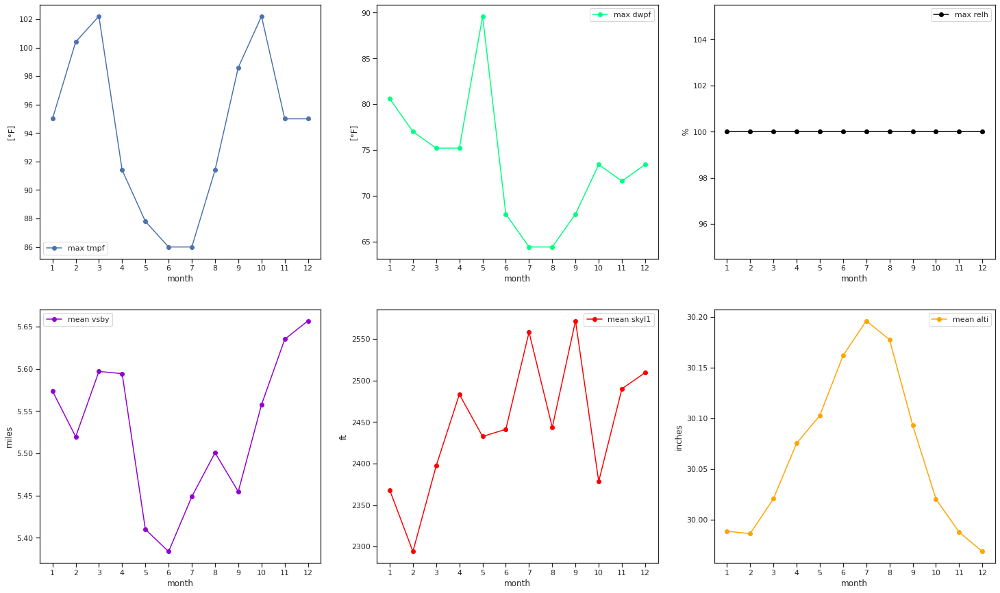

In [ ]:
plt.figure(figsize=(25,15))

# matplotlib colors: https://matplotlib.org/3.5.0/_images/sphx_glr_named_colors_003.png

plt.subplot(2, 3, 1)
plt.plot(df_agg_month.index.values, df_agg_month.tmpf['max'],'-o',color='b')
plt.xlabel('month')
plt.ylabel('[°F]')
plt.legend(['max tmpf'],loc='best')
plt.xticks(ticks=df_agg_month.index.values)

plt.subplot(2, 3, 2)
plt.plot(df_agg_month.index.values, df_agg_month.dwpf['max'],'-o',color='springgreen')
plt.xlabel('month')
plt.ylabel('[°F]')
plt.legend(['max dwpf'],loc='best')
plt.xticks(ticks=df_agg_month.index.values)

plt.subplot(2, 3, 3)
plt.plot(df_agg_month.index.values, df_agg_month.relh['max'],'-o',color='black')
plt.xlabel('month')
plt.ylabel('%')
plt.legend(['max relh'],loc='best')
plt.xticks(ticks=df_agg_month.index.values)

plt.subplot(2, 3, 4)
plt.plot(df_agg_month.index.values, df_agg_month.vsby['mean'],'-o',color='darkviolet')
plt.xlabel('month')
plt.ylabel('miles')
plt.legend(['mean vsby'],loc='best')
plt.xticks(ticks=df_agg_month.index.values)

plt.subplot(2, 3, 5)
plt.plot(df_agg_month.index.values, df_agg_month.skyl1['mean'],'-o',color='red')
plt.xlabel('month')
plt.ylabel('ft')
plt.legend(['mean skyl1'],loc='best')
plt.xticks(ticks=df_agg_month.index.values)

plt.subplot(2, 3, 6)
plt.plot(df_agg_month.index.values, df_agg_month.alti['mean'],'-o',color='orange')
plt.xlabel('month')
plt.ylabel('inches')
plt.legend(['mean alti'],loc='best')
plt.xticks(ticks=df_agg_month.index.values)

* **by Day of the Week**

In [ ]:
df_agg_dayofweek = df[['dayofweek_flag','tmpf', 'dwpf', 'relh', 'drct','sknt','alti','vsby','skyl1']].groupby(by='dayofweek_flag').agg(['min','mean','max'])
df_agg_dayofweek

tmpf                    dwpf                    relh  \
                 min       mean    max   min       mean   max    min   
dayofweek_flag                                                         
0               32.0  69.863881   95.0  32.0  59.902607  78.8  12.06   
1               32.0  69.775135  102.2  32.0  59.967271  77.0  12.84   
2               39.2  70.022241  100.4  32.0  59.992396  89.6  11.04   
3               32.0  70.049880   98.6  32.0  60.207576  78.8  10.85   
4               32.0  69.815043  102.2  32.0  60.243212  78.8  14.23   
5               39.2  70.044548   96.8  32.0  60.048086  78.8   9.56   
6               39.2  70.029899   96.8  32.0  60.012007  80.6   9.04   

                                 drct  ...  sknt  alti                    \
                     mean    max  min  ...   max   min       mean    max   
dayofweek_flag                         ...                                 
0               73.687170  100.0  0.0  ...  22.0  29.7  30.065257  30.50   
1               74.103427  100.0  0.0  ...  25.0  29.7  30.064909  30.50   
2               73.620358  100.0  0.0  ...  26.0  29.7  30.065889  30.50   
3               74.014952  100.0  0.0  ...  22.0  29.7  30.066830  30.47   
4               74.525478  100.0  0.0  ...  25.0  29.7  30.065918  30.45   
5               73.616910  100.0  0.0  ...  23.0  29.7  30.062337  30.45   
6               73.660969  100.0  0.0  ...  22.0  29.7  30.063981  30.47   

                vsby                  skyl1                       
                 min      mean   max    min         mean     max  
dayofweek_flag                                                    
0               0.06  5.514836  6.21  100.0  2455.645578  4900.0  
1               0.06  5.512633  6.21  100.0  2410.411311  4950.0  
2               0.06  5.545539  6.21  100.0  2468.226389  4900.0  
3               0.06  5.499475  6.21  100.0  2437.616099  4950.0  
4               0.03  5.481158  6.21  100.0  2397.228916  4900.0  
5               0.03  5.564005  6.21  100.0  2451.766328  4950.0  
6               0.03  5.577376  6.21  100.0  2509.153476  4950.0  

[7 rows x 24 columns]

([<matplotlib.axis.XTick at 0x7fa6fe43d5d0>,
 <a list of 7 Text major ticklabel objects>)

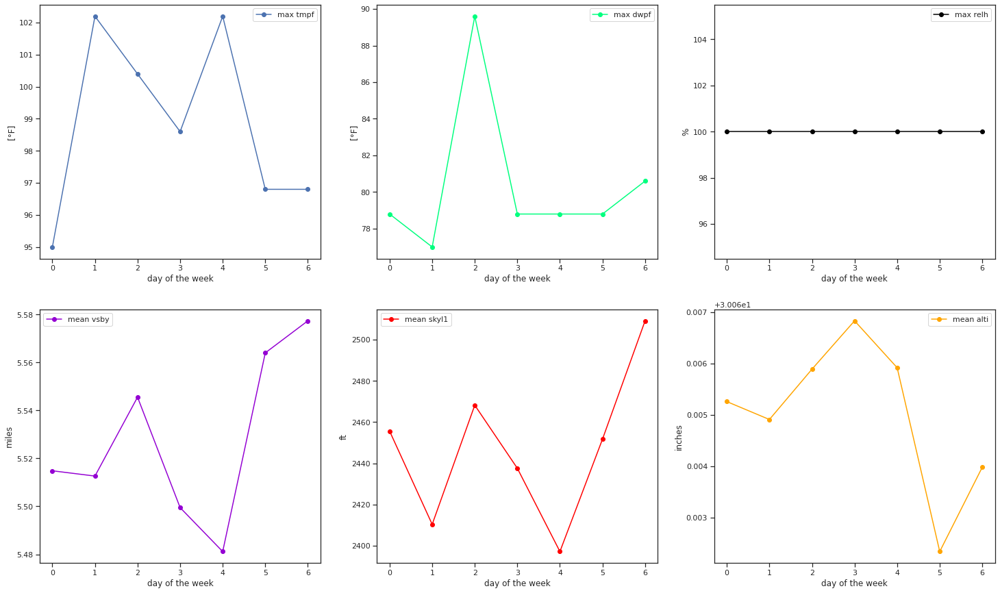

In [ ]:
plt.figure(figsize=(25,15))

# matplotlib colors: https://matplotlib.org/3.5.0/_images/sphx_glr_named_colors_003.png

plt.subplot(2, 3, 1)
plt.plot(df_agg_dayofweek.index.values, df_agg_dayofweek.tmpf['max'],'-o',color='b')
plt.xlabel('day of the week')
plt.ylabel('[°F]')
plt.legend(['max tmpf'],loc='best')
plt.xticks(ticks=df_agg_dayofweek.index.values)

plt.subplot(2, 3, 2)
plt.plot(df_agg_dayofweek.index.values, df_agg_dayofweek.dwpf['max'],'-o',color='springgreen')
plt.xlabel('day of the week')
plt.ylabel('[°F]')
plt.legend(['max dwpf'],loc='best')
plt.xticks(ticks=df_agg_dayofweek.index.values)

plt.subplot(2, 3, 3)
plt.plot(df_agg_dayofweek.index.values, df_agg_dayofweek.relh['max'],'-o',color='black')
plt.xlabel('day of the week')
plt.ylabel('%')
plt.legend(['max relh'],loc='best')
plt.xticks(ticks=df_agg_dayofweek.index.values)

plt.subplot(2, 3, 4)
plt.plot(df_agg_dayofweek.index.values, df_agg_dayofweek.vsby['mean'],'-o',color='darkviolet')
plt.xlabel('day of the week')
plt.ylabel('miles')
plt.legend(['mean vsby'],loc='best')
plt.xticks(ticks=df_agg_dayofweek.index.values)

plt.subplot(2, 3, 5)
plt.plot(df_agg_dayofweek.index.values, df_agg_dayofweek.skyl1['mean'],'-o',color='red')
plt.xlabel('day of the week')
plt.ylabel('ft')
plt.legend(['mean skyl1'],loc='best')
plt.xticks(ticks=df_agg_dayofweek.index.values)

plt.subplot(2, 3, 6)
plt.plot(df_agg_dayofweek.index.values, df_agg_dayofweek.alti['mean'],'-o',color='orange')
plt.xlabel('day of the week')
plt.ylabel('inches')
plt.legend(['mean alti'],loc='best')
plt.xticks(ticks=df_agg_dayofweek.index.values)

* **by Season**

In [ ]:
df_agg_season = df[['season_flag','tmpf', 'dwpf', 'relh', 'drct','sknt','alti','vsby','skyl1']].groupby(by='season_flag').agg(['min','mean','max'])
df_agg_season

tmpf                    dwpf                    relh             \
              min       mean    max   min       mean   max    min       mean   
season_flag                                                                    
autumn       32.0  70.313773  102.2  32.0  61.571860  89.6  18.55  76.078869   
spring       46.4  70.820556  102.2  32.0  59.310781  73.4   9.04  70.784713   
summer       32.0  74.338041  100.4  35.6  65.450206  80.6  18.56  76.249900   
winter       33.8  64.306981   91.4  32.0  53.847769  68.0  12.06  72.369306   

                   drct  ...  sknt  alti                    vsby            \
               max  min  ...   max   min       mean    max   min      mean   
season_flag              ...                                                 
autumn       100.0  0.0  ...  25.0  29.7  30.065820  30.36  0.03  5.533661   
spring       100.0  0.0  ...  23.0  29.7  30.033837  30.39  0.06  5.548791   
summer       100.0  0.0  ...  26.0  29.7  29.981330  30.24  0.06  5.584241   
winter       100.0  0.0  ...  17.0  29.7  30.178605  30.50  0.03  5.444947   

                   skyl1                       
              max    min         mean     max  
season_flag                                    
autumn       6.21  100.0  2436.962639  4950.0  
spring       6.21  100.0  2479.065588  4950.0  
summer       6.21  200.0  2391.644575  4950.0  
winter       6.21  100.0  2481.499853  4950.0  

[4 rows x 24 columns]

([<matplotlib.axis.XTick at 0x7fa6fe22d1d0>,
 <a list of 4 Text major ticklabel objects>)

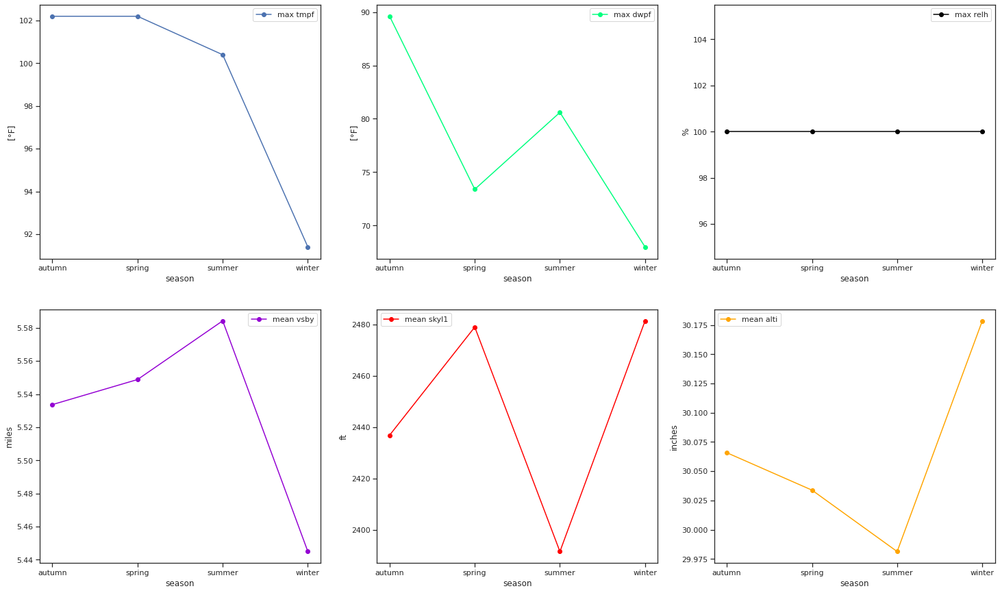

In [ ]:
plt.figure(figsize=(25,15))

# matplotlib colors: https://matplotlib.org/3.5.0/_images/sphx_glr_named_colors_003.png

plt.subplot(2, 3, 1)
plt.plot(df_agg_season.index.values, df_agg_season.tmpf['max'],'-o',color='b')
plt.xlabel('season')
plt.ylabel('[°F]')
plt.legend(['max tmpf'],loc='best')
plt.xticks(ticks=df_agg_season.index.values)

plt.subplot(2, 3, 2)
plt.plot(df_agg_season.index.values, df_agg_season.dwpf['max'],'-o',color='springgreen')
plt.xlabel('season')
plt.ylabel('[°F]')
plt.legend(['max dwpf'],loc='best')
plt.xticks(ticks=df_agg_season.index.values)

plt.subplot(2, 3, 3)
plt.plot(df_agg_season.index.values, df_agg_season.relh['max'],'-o',color='black')
plt.xlabel('season')
plt.ylabel('%')
plt.legend(['max relh'],loc='best')
plt.xticks(ticks=df_agg_season.index.values)

plt.subplot(2, 3, 4)
plt.plot(df_agg_season.index.values, df_agg_season.vsby['mean'],'-o',color='darkviolet')
plt.xlabel('season')
plt.ylabel('miles')
plt.legend(['mean vsby'],loc='best')
plt.xticks(ticks=df_agg_season.index.values)

plt.subplot(2, 3, 5)
plt.plot(df_agg_season.index.values, df_agg_season.skyl1['mean'],'-o',color='red')
plt.xlabel('season')
plt.ylabel('ft')
plt.legend(['mean skyl1'],loc='best')
plt.xticks(ticks=df_agg_season.index.values)

plt.subplot(2, 3, 6)
plt.plot(df_agg_season.index.values, df_agg_season.alti['mean'],'-o',color='orange')
plt.xlabel('season')
plt.ylabel('inches')
plt.legend(['mean alti'],loc='best')
plt.xticks(ticks=df_agg_season.index.values)

#### (ix) Time Series

In [ ]:
fig = px.area(df[['fr_code','tmpf', 'dwpf', 'relh', 'drct','sknt','alti','vsby','skyl1']], facet_col="fr_code",facet_col_wrap=2)
fig.show()

In [ ]:
fig = px.line(df, x='valid', y='tmpf', title='Air Temperature [°F]')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [ ]:
fig = px.line(df, x='valid', y='sknt', title='Wind Speed [knots]')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [ ]:
fig = px.line(df, x='valid', y='alti', title='Pressure altimeter [inches]')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

### 3- Machine Learning Algorythm

#### (i) Creating a new DataFrame

In [286]:
# Creating a copy from the previous DF
df_model = df.copy()
df_model.head()

,valid,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,metar,year,month,dayofweek_flag,day,hour,min,season_flag,fr_code
0,2017-01-01 00:00:00,71.6,71.6,100.00,60.0,2.0,30.03,6.21,FEW,3000.0,73.16,SBSJ 010000Z 06002KT 9999 FEW030 22/22 Q1017,2017,1,6,1,0,0,summer,MVFR
1,2017-01-01 01:00:00,71.6,69.8,94.06,0.0,0.0,30.03,6.21,FEW,3000.0,72.88,SBSJ 010100Z 00000KT 9999 FEW030 22/21 Q1017,2017,1,6,1,1,0,summer,MVFR
2,2017-01-01 02:00:00,71.6,68.0,88.43,260.0,2.0,30.06,6.21,FEW,3000.0,72.62,SBSJ 010200Z 26002KT 9999 FEW030 22/20 Q1018,2017,1,6,1,2,0,summer,MVFR
3,2017-01-01 03:00:00,71.6,71.6,100.00,50.0,6.0,30.03,6.21,FEW,3000.0,73.16,SBSJ 010300Z 05006KT 9999 FEW030 SCT040 22/22 ...,2017,1,6,1,3,0,summer,MVFR
4,2017-01-01 04:00:00,71.6,69.8,94.06,60.0,5.0,30.00,6.21,FEW,3000.0,72.88,SBSJ 010400Z 06005KT 9999 FEW030 22/21 Q1016,2017,1,6,1,4,0,summer,MVFR


* First we need to filter the data that was logged hourly

In [181]:
df_model.loc[df['min']!=0] # Checking the values that don't match with our 'hourly' logged data

,valid,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,metar,year,month,dayofweek_flag,day,hour,min,season_flag,fr_code
68,2017-01-03 19:15:00,75.2,66.2,73.61,360.0,13.0,29.88,0.93,SCT,1500.0,75.20,SBSJ 031915Z 36013KT 1500 R33/P2000 R15/P2000 ...,2017,1,1,3,19,15,summer,MVFR
83,2017-01-04 09:25:00,69.8,69.8,100.00,350.0,2.0,29.97,3.11,BKN,400.0,69.80,SBSJ 040925Z 35002KT 5000 BR BKN004 BKN070 21/...,2017,1,2,4,9,25,summer,MVFR
166,2017-01-07 19:10:00,71.6,69.8,94.06,240.0,20.0,30.03,0.37,FEW,800.0,72.88,SBSJ 071910Z 24020KT 0600 TSRA FEW008CB BKN008...,2017,1,5,7,19,10,summer,IFR
213,2017-01-09 20:40:00,73.4,69.8,88.51,200.0,9.0,29.91,0.62,FEW,3000.0,74.60,SBSJ 092040Z 20009KT 1000 TSRA FEW030CB BKN040...,2017,1,0,9,20,40,summer,MVFR
238,2017-01-10 20:20:00,84.2,71.6,65.95,190.0,11.0,29.83,4.35,SCT,2000.0,89.60,SBSJ 102020Z 19011KT 7000 TSRA SCT020 BKN025 F...,2017,1,1,10,20,20,summer,MVFR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40642,2021-12-28 16:42:00,78.8,57.2,47.52,270.0,8.0,29.97,6.21,FEW,3500.0,78.80,SBSJ 281642Z 27008KT 9999 TS FEW035 FEW040CB S...,2021,12,1,28,16,42,summer,VFR
40663,2021-12-29 19:03:00,66.2,62.6,88.18,340.0,10.0,29.97,1.86,BKN,3000.0,66.20,SBSJ 291903Z 34010KT 310V010 3000 TSRA BR BKN0...,2021,12,2,29,19,3,summer,MVFR
40664,2021-12-29 19:40:00,62.6,60.8,93.83,340.0,26.0,30.00,0.06,BKN,500.0,62.60,SBSJ 291940Z 34026G39KT 310V020 0100 R34///// ...,2021,12,2,29,19,40,summer,LIFR
40666,2021-12-29 20:20:00,66.2,64.4,93.92,130.0,7.0,29.97,2.49,SCT,1300.0,66.20,SBSJ 292020Z 13007KT 100V160 4000 BR TS SCT013...,2021,12,2,29,20,20,summer,MVFR


In [182]:
# Counting the frequency registered by each minute log
df_model['min'].value_counts()

0     40301
15       26
30       23
20       22
25       21
35       16
10       14
45       13
24       11
38       11
32       10
13       10
34       10
18       10
39       10
31       10
40        9
5         9
33        8
14        7
16        7
41        7
22        7
3         7
21        7
12        7
26        6
8         6
23        6
37        6
17        6
28        6
43        5
36        5
29        5
6         4
11        4
44        4
27        4
42        3
4         3
46        3
7         3
1         3
2         3
50        2
9         2
19        2
54        1
59        1
58        1
47        1
Name: min, dtype: int64

* **Hourly Logged DataFrame**

In [287]:
df_model = df_model.loc[df['min']==0] # values registered from hour to hour
df_model

,valid,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,metar,year,month,dayofweek_flag,day,hour,min,season_flag,fr_code
0,2017-01-01 00:00:00,71.6,71.6,100.00,60.0,2.0,30.03,6.21,FEW,3000.0,73.16,SBSJ 010000Z 06002KT 9999 FEW030 22/22 Q1017,2017,1,6,1,0,0,summer,MVFR
1,2017-01-01 01:00:00,71.6,69.8,94.06,0.0,0.0,30.03,6.21,FEW,3000.0,72.88,SBSJ 010100Z 00000KT 9999 FEW030 22/21 Q1017,2017,1,6,1,1,0,summer,MVFR
2,2017-01-01 02:00:00,71.6,68.0,88.43,260.0,2.0,30.06,6.21,FEW,3000.0,72.62,SBSJ 010200Z 26002KT 9999 FEW030 22/20 Q1018,2017,1,6,1,2,0,summer,MVFR
3,2017-01-01 03:00:00,71.6,71.6,100.00,50.0,6.0,30.03,6.21,FEW,3000.0,73.16,SBSJ 010300Z 05006KT 9999 FEW030 SCT040 22/22 ...,2017,1,6,1,3,0,summer,MVFR
4,2017-01-01 04:00:00,71.6,69.8,94.06,60.0,5.0,30.00,6.21,FEW,3000.0,72.88,SBSJ 010400Z 06005KT 9999 FEW030 22/21 Q1016,2017,1,6,1,4,0,summer,MVFR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40682,2021-12-30 19:00:00,69.8,66.2,88.34,140.0,9.0,29.88,4.97,SCT,1100.0,69.80,SBSJ 301900Z 14009KT 8000 SCT011 BKN020 BKN050...,2021,12,3,30,19,0,summer,MVFR
40683,2021-12-30 20:00:00,69.8,66.2,88.34,130.0,8.0,29.85,4.97,SCT,1800.0,69.80,SBSJ 302000Z 13008KT 8000 SCT018 BKN027 BKN040...,2021,12,3,30,20,0,summer,MVFR
40684,2021-12-30 21:00:00,69.8,64.4,82.98,130.0,9.0,29.85,6.21,SCT,1800.0,69.80,SBSJ 302100Z 13009KT 9999 SCT018 BKN033 OVC080...,2021,12,3,30,21,0,summer,MVFR
40686,2021-12-30 22:00:00,68.0,66.2,93.97,110.0,8.0,29.88,1.86,SCT,1200.0,68.00,SBSJ 302200Z 11008KT 3000 -RA BR SCT012 BKN023...,2021,12,3,30,22,0,summer,MVFR


In [288]:
# Confirming the changes
df_model['min'].value_counts()

0    40301
Name: min, dtype: int64

* Selecting variables of interest (summarized data)

In [289]:
df_model_s = df_model.drop(['valid','metar','year','day','hour','min'],axis=1)
df_model_s

,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,month,dayofweek_flag,season_flag,fr_code
0,71.6,71.6,100.00,60.0,2.0,30.03,6.21,FEW,3000.0,73.16,1,6,summer,MVFR
1,71.6,69.8,94.06,0.0,0.0,30.03,6.21,FEW,3000.0,72.88,1,6,summer,MVFR
2,71.6,68.0,88.43,260.0,2.0,30.06,6.21,FEW,3000.0,72.62,1,6,summer,MVFR
3,71.6,71.6,100.00,50.0,6.0,30.03,6.21,FEW,3000.0,73.16,1,6,summer,MVFR
4,71.6,69.8,94.06,60.0,5.0,30.00,6.21,FEW,3000.0,72.88,1,6,summer,MVFR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40682,69.8,66.2,88.34,140.0,9.0,29.88,4.97,SCT,1100.0,69.80,12,3,summer,MVFR
40683,69.8,66.2,88.34,130.0,8.0,29.85,4.97,SCT,1800.0,69.80,12,3,summer,MVFR
40684,69.8,64.4,82.98,130.0,9.0,29.85,6.21,SCT,1800.0,69.80,12,3,summer,MVFR
40686,68.0,66.2,93.97,110.0,8.0,29.88,1.86,SCT,1200.0,68.00,12,3,summer,MVFR


#### (ii) One-Hot encoding

* **Changing month and day_of_week values**

In [290]:
new_val_month = []
new_val_dow = []

for m,d in zip(df_model_s.month.values, df_model_s.dayofweek_flag.values):
  
  # for months
  if m==1:
    new_val_month.append('Jan')
  elif m==2:
    new_val_month.append('Feb')
  elif m==3:
    new_val_month.append('Mar')
  elif m==4:
    new_val_month.append('Apr')
  elif m==5:
    new_val_month.append('May')
  elif m==6:
    new_val_month.append('Jun')
  elif m==7:
    new_val_month.append('Jul')
  elif m==8:
    new_val_month.append('Aug')
  elif m==9:
    new_val_month.append('Sep')
  elif m==10:
    new_val_month.append('Oct')
  elif m==11:
    new_val_month.append('Nov')
  else:
    new_val_month.append('Dec')

  # for days of the week:
  if d==0:
    new_val_dow.append('Sun')
  elif d==1:
    new_val_dow.append('Mon')
  elif d==2:
    new_val_dow.append('Tues')
  elif d==3:
    new_val_dow.append('Wed')
  elif d==4:
    new_val_dow.append('Thurs')
  elif d==5:
    new_val_dow.append('Fri')
  else:
    new_val_dow.append('Sat')


df_model_s['month'] = new_val_month
df_model_s['dayofweek_flag'] = new_val_dow
df_model_s.head()

,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyc1,skyl1,feel,month,dayofweek_flag,season_flag,fr_code
0,71.6,71.6,100.00,60.0,2.0,30.03,6.21,FEW,3000.0,73.16,Jan,Sat,summer,MVFR
1,71.6,69.8,94.06,0.0,0.0,30.03,6.21,FEW,3000.0,72.88,Jan,Sat,summer,MVFR
2,71.6,68.0,88.43,260.0,2.0,30.06,6.21,FEW,3000.0,72.62,Jan,Sat,summer,MVFR
3,71.6,71.6,100.00,50.0,6.0,30.03,6.21,FEW,3000.0,73.16,Jan,Sat,summer,MVFR
4,71.6,69.8,94.06,60.0,5.0,30.00,6.21,FEW,3000.0,72.88,Jan,Sat,summer,MVFR


* **Encoding**

In [291]:
df_model_s = pd.get_dummies(df_model_s, columns=['skyc1','month','dayofweek_flag','season_flag', 'fr_code'])
df_model_s

,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyl1,feel,skyc1_BKN,...,dayofweek_flag_Tues,dayofweek_flag_Wed,season_flag_autumn,season_flag_spring,season_flag_summer,season_flag_winter,fr_code_IFR,fr_code_LIFR,fr_code_MVFR,fr_code_VFR
0,71.6,71.6,100.00,60.0,2.0,30.03,6.21,3000.0,73.16,0,...,0,0,0,0,1,0,0,0,1,0
1,71.6,69.8,94.06,0.0,0.0,30.03,6.21,3000.0,72.88,0,...,0,0,0,0,1,0,0,0,1,0
2,71.6,68.0,88.43,260.0,2.0,30.06,6.21,3000.0,72.62,0,...,0,0,0,0,1,0,0,0,1,0
3,71.6,71.6,100.00,50.0,6.0,30.03,6.21,3000.0,73.16,0,...,0,0,0,0,1,0,0,0,1,0
4,71.6,69.8,94.06,60.0,5.0,30.00,6.21,3000.0,72.88,0,...,0,0,0,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40682,69.8,66.2,88.34,140.0,9.0,29.88,4.97,1100.0,69.80,0,...,0,1,0,0,1,0,0,0,1,0
40683,69.8,66.2,88.34,130.0,8.0,29.85,4.97,1800.0,69.80,0,...,0,1,0,0,1,0,0,0,1,0
40684,69.8,64.4,82.98,130.0,9.0,29.85,6.21,1800.0,69.80,0,...,0,1,0,0,1,0,0,0,1,0
40686,68.0,66.2,93.97,110.0,8.0,29.88,1.86,1200.0,68.00,0,...,0,1,0,0,1,0,0,0,1,0


#### (iii) Creating X,y matrices

For this analysis, we are going to consider an 'hourly' prediction, e.g, we use the previous data to predict the next hour variables of interest. Our data will be structured as following:

* X: has all the variables, including only 'even' rows;
  * columns: **['tmpf', 'dwpf', 'relh', 'drct', 'sknt', 'alti', 'vsby', 'skyl1', 'feel',
       'skyc1_BKN', 'skyc1_FEW', 'skyc1_NSC', 'skyc1_OVC', 'skyc1_SCT',
       'skyc1_VV ', 'month_apr', 'month_aug', 'month_dec', 'month_feb',
       'month_jan', 'month_jul', 'month_jun', 'month_mar', 'month_may',
       'month_nov', 'month_oct', 'month_sep', 'dayofweek_flag_fri',
       'dayofweek_flag_mon', 'dayofweek_flag_sat', 'dayofweek_flag_sun',
       'dayofweek_flag_thurs', 'dayofweek_flag_tues', 'dayofweek_flag_wed',
       'season_flag_autumn', 'season_flag_spring', 'season_flag_summer',
       'season_flag_winter', 'fr_code_IFR', 'fr_code_LIFR', 'fr_code_MVFR',
       'fr_code_VFR']**
* y: has the interest variables to be predicted, e.g, the float ones. Includes the 'odd' rows;
  * columns: **['tmpf', 'relh', 'sknt', 'alti', 'vsby', 'skyl1']**

In [292]:
# To make an hourly prediction we need to have the total number of rows as an even number:

if len(df_model_s)%2 == 1: #division by 2 results 1 for odd numbers and 0 for even numbers
  df_model_s = df_model_s.iloc[[x for x in range(0,len(df_model_s)-1)]] #discards the last row
else:
  pass

df_model_s

,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyl1,feel,skyc1_BKN,...,dayofweek_flag_Tues,dayofweek_flag_Wed,season_flag_autumn,season_flag_spring,season_flag_summer,season_flag_winter,fr_code_IFR,fr_code_LIFR,fr_code_MVFR,fr_code_VFR
0,71.6,71.6,100.00,60.0,2.0,30.03,6.21,3000.0,73.16,0,...,0,0,0,0,1,0,0,0,1,0
1,71.6,69.8,94.06,0.0,0.0,30.03,6.21,3000.0,72.88,0,...,0,0,0,0,1,0,0,0,1,0
2,71.6,68.0,88.43,260.0,2.0,30.06,6.21,3000.0,72.62,0,...,0,0,0,0,1,0,0,0,1,0
3,71.6,71.6,100.00,50.0,6.0,30.03,6.21,3000.0,73.16,0,...,0,0,0,0,1,0,0,0,1,0
4,71.6,69.8,94.06,60.0,5.0,30.00,6.21,3000.0,72.88,0,...,0,0,0,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40681,73.4,64.4,73.44,80.0,3.0,29.88,6.21,3000.0,73.40,0,...,0,1,0,0,1,0,0,0,1,0
40682,69.8,66.2,88.34,140.0,9.0,29.88,4.97,1100.0,69.80,0,...,0,1,0,0,1,0,0,0,1,0
40683,69.8,66.2,88.34,130.0,8.0,29.85,4.97,1800.0,69.80,0,...,0,1,0,0,1,0,0,0,1,0
40684,69.8,64.4,82.98,130.0,9.0,29.85,6.21,1800.0,69.80,0,...,0,1,0,0,1,0,0,0,1,0


* **X, y matrices:**

In [293]:
start_x, end_x = 0, len(df_model_s)-1

# iterating each number in list
x_pos = []
for num in range(start_x, end_x):
    # checking condition
    if num % 2 == 0:
        x_pos.append(num)

X = df_model_s.iloc[x_pos]
X 

,tmpf,dwpf,relh,drct,sknt,alti,vsby,skyl1,feel,skyc1_BKN,...,dayofweek_flag_Tues,dayofweek_flag_Wed,season_flag_autumn,season_flag_spring,season_flag_summer,season_flag_winter,fr_code_IFR,fr_code_LIFR,fr_code_MVFR,fr_code_VFR
0,71.6,71.6,100.00,60.0,2.0,30.03,6.21,3000.0,73.16,0,...,0,0,0,0,1,0,0,0,1,0
2,71.6,68.0,88.43,260.0,2.0,30.06,6.21,3000.0,72.62,0,...,0,0,0,0,1,0,0,0,1,0
4,71.6,69.8,94.06,60.0,5.0,30.00,6.21,3000.0,72.88,0,...,0,0,0,0,1,0,0,0,1,0
6,69.8,69.8,100.00,350.0,2.0,29.97,6.21,3000.0,69.80,0,...,0,0,0,0,1,0,0,0,1,0
8,69.8,68.0,94.01,60.0,2.0,30.00,6.21,2000.0,69.80,0,...,0,0,0,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40676,71.6,64.4,78.04,10.0,4.0,30.00,3.73,1500.0,71.60,0,...,0,1,0,0,1,0,0,0,1,0
40678,73.4,66.2,78.19,40.0,3.0,29.97,3.11,1300.0,73.40,0,...,0,1,0,0,1,0,0,0,1,0
40680,75.2,62.6,64.91,80.0,4.0,29.91,6.21,2000.0,75.20,0,...,0,1,0,0,1,0,0,0,1,0
40682,69.8,66.2,88.34,140.0,9.0,29.88,4.97,1100.0,69.80,0,...,0,1,0,0,1,0,0,0,1,0


In [294]:
start_y, end_y = 1, len(df_model_s)

# iterating each number in list
y_pos = []
for num in range(start_y, end_y):
    # checking condition
    if num % 2 != 0:
        y_pos.append(num)

y = df_model_s[['tmpf', 'relh', 'sknt', 'alti', 'vsby', 'skyl1']].iloc[y_pos]
y

,tmpf,relh,sknt,alti,vsby,skyl1
1,71.6,94.06,0.0,30.03,6.21,3000.0
3,71.6,100.00,6.0,30.03,6.21,3000.0
5,71.6,88.43,4.0,30.00,6.21,3000.0
7,69.8,94.01,2.0,29.97,6.21,2000.0
9,69.8,100.00,2.0,30.00,4.97,2000.0
...,...,...,...,...,...,...
40677,73.4,73.44,4.0,29.97,3.11,1900.0
40679,73.4,73.44,5.0,29.94,3.73,1800.0
40681,73.4,73.44,3.0,29.88,6.21,3000.0
40683,69.8,88.34,8.0,29.85,4.97,1800.0


#### (iv) Train/test data

In [295]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 42)

print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(15112, 42)
(5038, 42)
(15112, 6)
(5038, 6)


#### (v) Gradient Boosting Regressor

* **Model Setup**

In [297]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.multioutput import MultiOutputRegressor
from sklearn.model_selection import RandomizedSearchCV

model = MultiOutputRegressor(GradientBoostingRegressor(loss='ls', learning_rate=0.1, n_estimators=100, subsample=1.0,
                                                       criterion='friedman_mse', min_samples_split=2,
                                                       min_samples_leaf=1,
                                                       min_weight_fraction_leaf=0.0, max_depth=3,
                                                       min_impurity_decrease=0.0, init=None, random_state=42,
                                                       max_features=None,
                                                       alpha=0.9, verbose=0, max_leaf_nodes=None, warm_start=False,
                                                       validation_fraction=0.1, n_iter_no_change=None, tol=0.0001,
                                                       ccp_alpha=0.0))

hyperparameters = dict(estimator__learning_rate=[0.05, 0.1, 0.2, 0.5, 0.9], estimator__loss=['squared_error', 'lad', 'huber'],
                     estimator__n_estimators=[20, 50, 100, 200, 300, 500, 700, 1000],
                     estimator__criterion=['friedman_mse', 'mse'], estimator__min_samples_split=[2, 4, 7, 10],
                     estimator__max_depth=[3, 5, 10, 15, 20, 30], estimator__min_samples_leaf=[1, 2, 3, 5, 8, 10],
                     estimator__min_impurity_decrease=[0, 0.2, 0.4, 0.6, 0.8],
                     estimator__max_leaf_nodes=[5, 10, 20, 30, 50, 100, 300])

randomized_search = RandomizedSearchCV(model, hyperparameters, random_state=42, n_iter=5, scoring=None,
                                       n_jobs=2, refit=True, cv=5, verbose=True,
                                       pre_dispatch='2*n_jobs', error_score='raise', return_train_score=True)

In [298]:
hyperparameters_tuning = randomized_search.fit(X_train, y_train)
print('Best Parameters = {}'.format(hyperparameters_tuning.best_params_))

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Parameters = {'estimator__n_estimators': 700, 'estimator__min_samples_split': 2, 'estimator__min_samples_leaf': 2, 'estimator__min_impurity_decrease': 0, 'estimator__max_leaf_nodes': 10, 'estimator__max_depth': 3, 'estimator__loss': 'squared_error', 'estimator__learning_rate': 0.1, 'estimator__criterion': 'friedman_mse'}


In [300]:
reg_model = MultiOutputRegressor(GradientBoostingRegressor(max_leaf_nodes=10, min_impurity_decrease=0,
                                                                                                                   min_samples_leaf=2,min_samples_split=2,n_estimators=700,
                                                                                                                   max_depth=3,loss='squared_error',learning_rate=0.1,criterion='friedman_mse'))

reg_model = reg_model.fit(X_train, y_train)

#### (vi) Results

* **Predicted Values (y)**

In [301]:
# y_pred = hyperparameters_tuning.best_estimator_
# y_pred = y_pred.predict(X_test)

y_pred = reg_model.predict(X_test)
y_pred

array([[6.29994890e+01, 9.21031092e+01, 1.69544635e+00, 3.00603219e+01,
        5.68378252e+00, 2.46997404e+03],
       [6.53074576e+01, 8.41277616e+01, 7.28986569e+00, 2.99498389e+01,
        5.93277448e+00, 1.95354065e+03],
       [6.43376587e+01, 9.21562947e+01, 1.95389967e+00, 3.00909471e+01,
        6.01053417e+00, 2.66080134e+03],
       ...,
       [6.61862778e+01, 9.28834686e+01, 2.11037920e+00, 2.98836773e+01,
        4.56948874e+00, 2.30747616e+03],
       [7.37770842e+01, 7.56117211e+01, 1.11524184e+01, 2.99844271e+01,
        5.88901062e+00, 3.40142454e+03],
       [7.72036565e+01, 4.17815998e+01, 3.63139717e+00, 3.00555608e+01,
        6.14569790e+00, 3.09137300e+03]])

* **Model Interpretability**

Selected y: vsby
Selected tree: 52


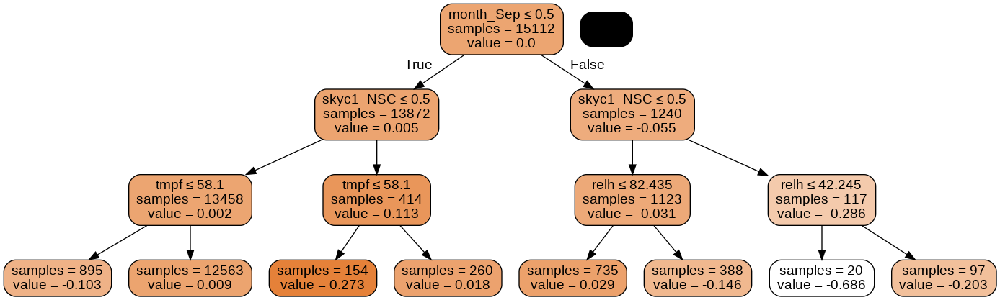

In [321]:
from sklearn.tree import export_graphviz
import random

y_col_random = random.randint(0, y.shape[1]-1) #selects a random column (y) for visualization
print(f'Selected y: {y.columns[y_col_random]}')
x_var, y_var = X_train, y_train.values[:,y_col_random]

model = GradientBoostingRegressor(max_leaf_nodes=10, min_impurity_decrease=0,
                                                                                                                   min_samples_leaf=2,min_samples_split=2,n_estimators=700,
                                                                                                                   max_depth=3,loss='squared_error',learning_rate=0.1,criterion='friedman_mse').fit(x_var, y_var)

# Get the tree number
random_tree_number = random.randint(0,100) # selects a random tree number for visualization
print(f'Selected tree: {random_tree_number}')
sub_tree = model.estimators_[random_tree_number, 0]

# Visualization
# Install graphviz: https://www.graphviz.org/download/
from pydotplus import graph_from_dot_data
from IPython.display import Image
dot_data = export_graphviz(
    sub_tree,
    out_file=None, filled=True, rounded=True,
    special_characters=True,
    proportion=False, impurity=False, # enable them if you want
    feature_names = list(X.columns)
)
graph = graph_from_dot_data(dot_data)
Image(graph.create_png())

In [197]:
!pip install shap

In [303]:
# https://github.com/slundberg/shap
import shap

---
>> **tmpf**
---

In [315]:
x_var, y_var = X_train, y_train.values[:,0]

model = GradientBoostingRegressor(max_leaf_nodes=10, min_impurity_decrease=0,
                                                                                                                   min_samples_leaf=2,min_samples_split=2,n_estimators=700,
                                                                                                                   max_depth=3,loss='squared_error',learning_rate=0.1,criterion='friedman_mse').fit(x_var, y_var)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(x_var)

In [316]:
# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[0])

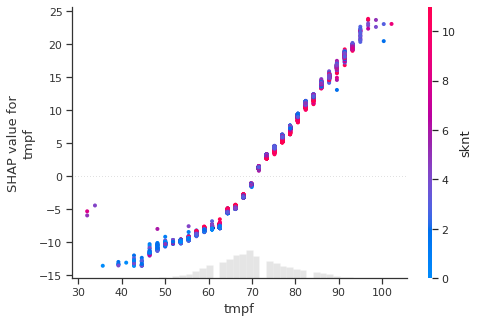

In [317]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,0], color=shap_values)

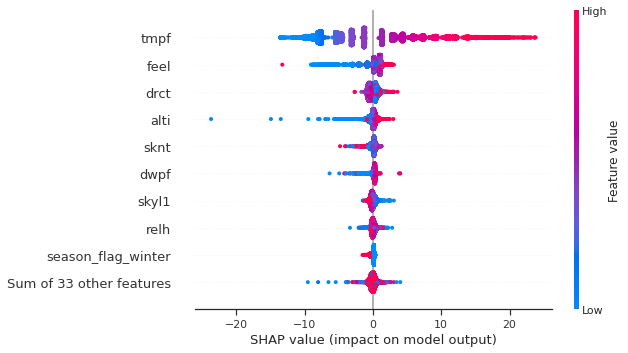

In [318]:
# summarize the effects of all the features
shap.initjs()
shap.plots.beeswarm(shap_values)

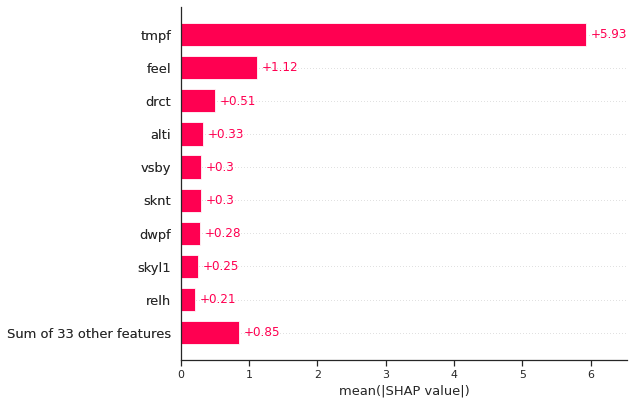

In [319]:
#take the mean absolute value of the SHAP values for each feature to get a standard bar plot
shap.initjs()
shap.plots.bar(shap_values)

---
>> **relh**
---

In [322]:
x_var, y_var = X_train, y_train.values[:,1]

model = GradientBoostingRegressor(max_leaf_nodes=10, min_impurity_decrease=0,
                                                                                                                   min_samples_leaf=2,min_samples_split=2,n_estimators=700,
                                                                                                                   max_depth=3,loss='squared_error',learning_rate=0.1,criterion='friedman_mse').fit(x_var, y_var)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(x_var)

In [323]:
# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[0])

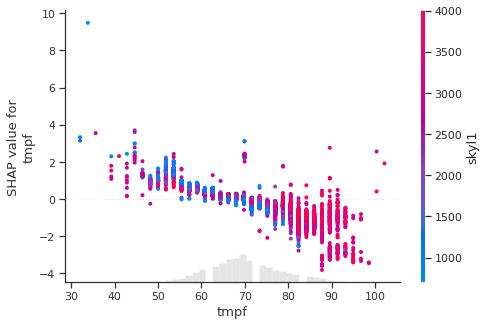

In [324]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,0], color=shap_values)

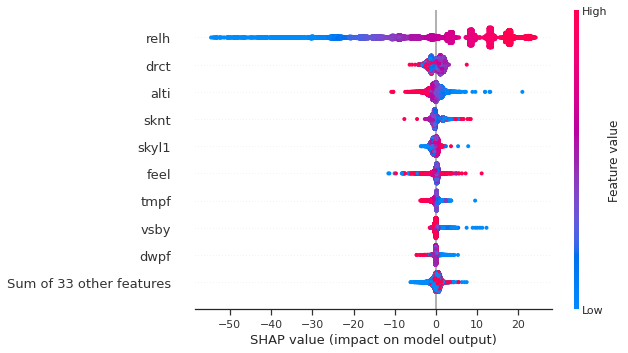

In [325]:
# summarize the effects of all the features
shap.initjs()
shap.plots.beeswarm(shap_values)

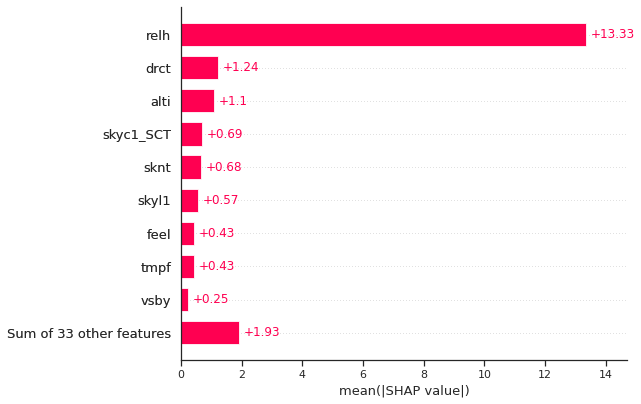

In [326]:
#take the mean absolute value of the SHAP values for each feature to get a standard bar plot
shap.initjs()
shap.plots.bar(shap_values)

---
>> **sknt**
---

In [327]:
x_var, y_var = X_train, y_train.values[:,2]

model = GradientBoostingRegressor(max_leaf_nodes=10, min_impurity_decrease=0,
                                                                                                                   min_samples_leaf=2,min_samples_split=2,n_estimators=700,
                                                                                                                   max_depth=3,loss='squared_error',learning_rate=0.1,criterion='friedman_mse').fit(x_var, y_var)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(x_var)

In [328]:
# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[0])

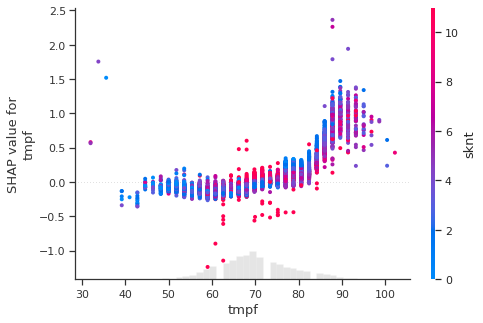

In [329]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,0], color=shap_values)

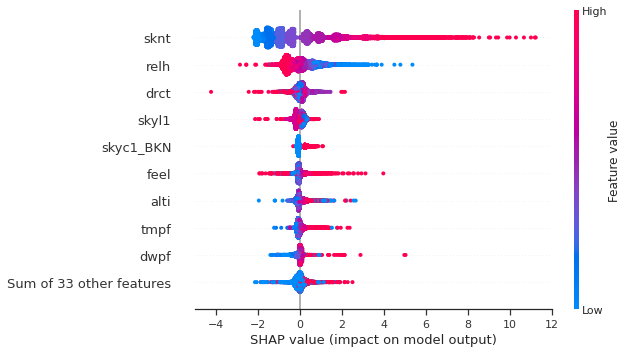

In [330]:
# summarize the effects of all the features
shap.initjs()
shap.plots.beeswarm(shap_values)

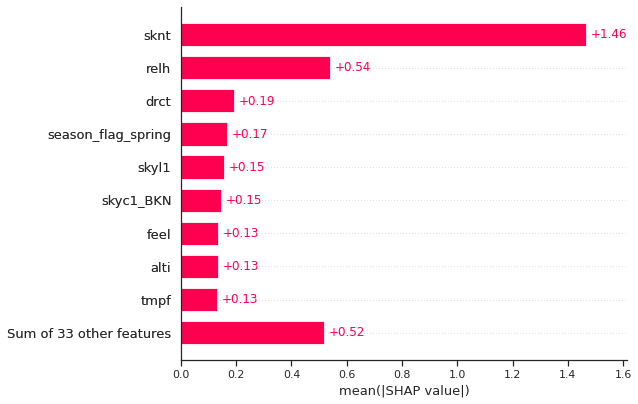

In [331]:
#take the mean absolute value of the SHAP values for each feature to get a standard bar plot
shap.initjs()
shap.plots.bar(shap_values)

---
>> **alti**
---

In [332]:
x_var, y_var = X_train, y_train.values[:,3]

model = GradientBoostingRegressor(max_leaf_nodes=10, min_impurity_decrease=0,
                                                                                                                   min_samples_leaf=2,min_samples_split=2,n_estimators=700,
                                                                                                                   max_depth=3,loss='squared_error',learning_rate=0.1,criterion='friedman_mse').fit(x_var, y_var)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(x_var)

In [333]:
# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[0])

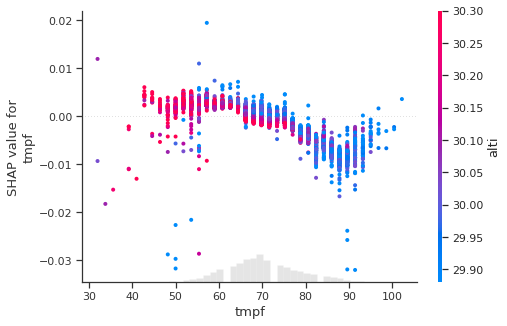

In [334]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,0], color=shap_values)

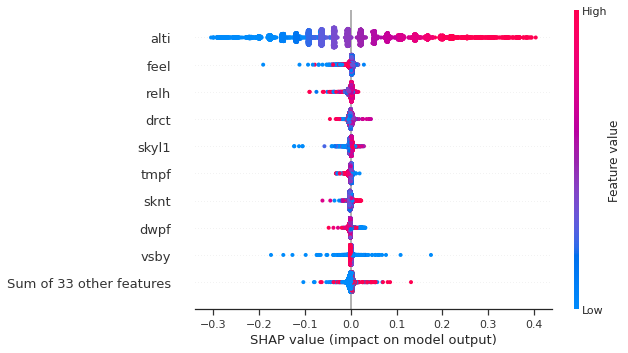

In [335]:
# summarize the effects of all the features
shap.initjs()
shap.plots.beeswarm(shap_values)

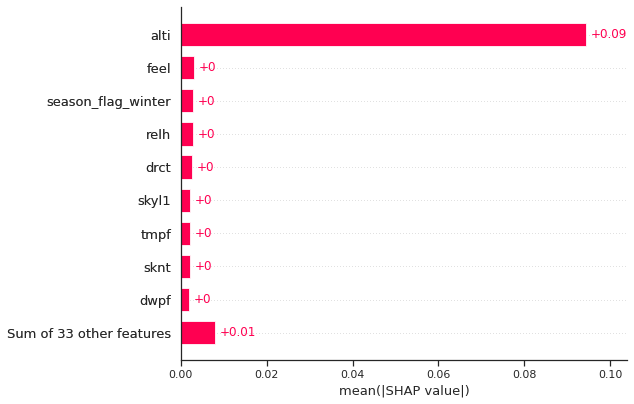

In [336]:
#take the mean absolute value of the SHAP values for each feature to get a standard bar plot
shap.initjs()
shap.plots.bar(shap_values)

---
>> **vsby**
---

In [338]:
x_var, y_var = X_train, y_train.values[:,4]

model = GradientBoostingRegressor(max_leaf_nodes=10, min_impurity_decrease=0,
                                                                                                                   min_samples_leaf=2,min_samples_split=2,n_estimators=700,
                                                                                                                   max_depth=3,loss='squared_error',learning_rate=0.1,criterion='friedman_mse').fit(x_var, y_var)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(x_var)

In [339]:
# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[0])

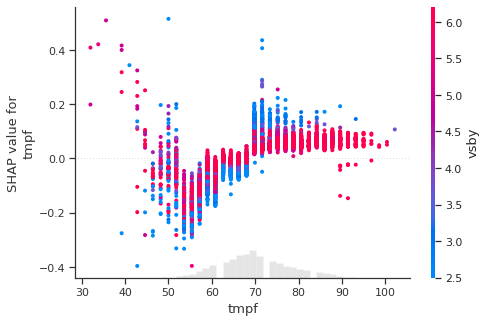

In [340]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,0], color=shap_values)

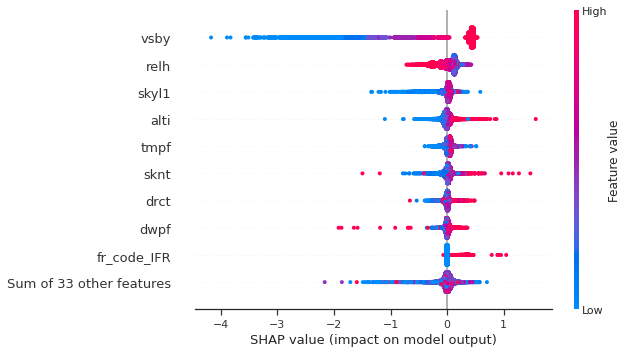

In [341]:
# summarize the effects of all the features
shap.initjs()
shap.plots.beeswarm(shap_values)

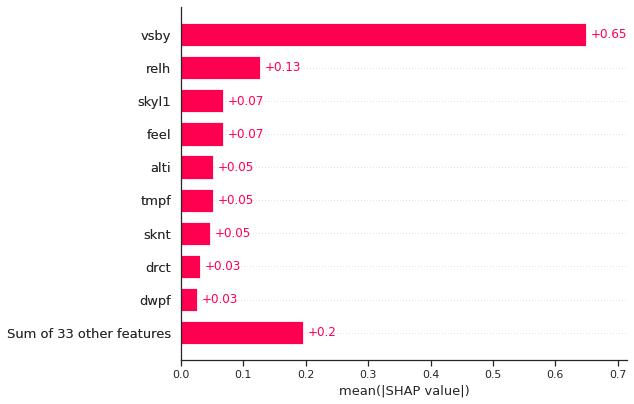

In [342]:
#take the mean absolute value of the SHAP values for each feature to get a standard bar plot
shap.initjs()
shap.plots.bar(shap_values)

---
>> **skyl1**
---

In [343]:
x_var, y_var = X_train, y_train.values[:,5]

model = GradientBoostingRegressor(max_leaf_nodes=10, min_impurity_decrease=0,
                                                                                                                   min_samples_leaf=2,min_samples_split=2,n_estimators=700,
                                                                                                                   max_depth=3,loss='squared_error',learning_rate=0.1,criterion='friedman_mse').fit(x_var, y_var)

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(x_var)

In [344]:
# visualize the first prediction's explanation with a force plot
shap.initjs()
shap.plots.force(shap_values[0])

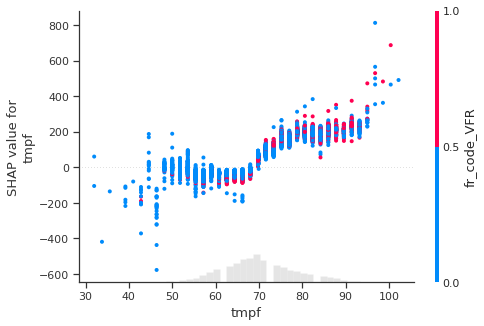

In [345]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.initjs()
shap.plots.scatter(shap_values[:,0], color=shap_values)

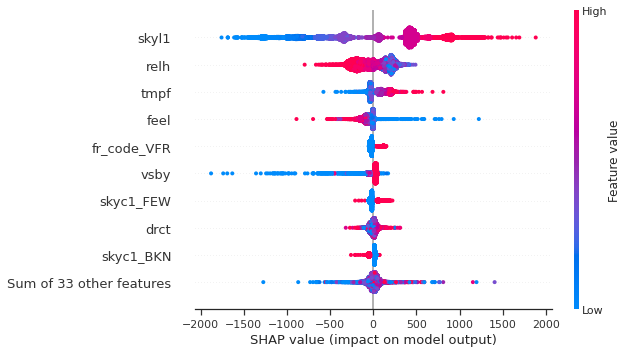

In [346]:
# summarize the effects of all the features
shap.initjs()
shap.plots.beeswarm(shap_values)

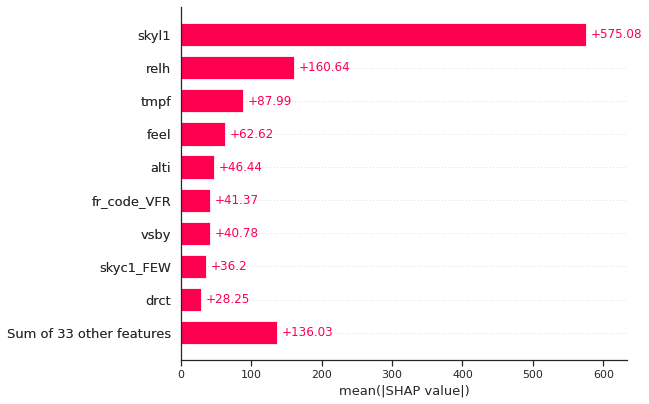

In [347]:
#take the mean absolute value of the SHAP values for each feature to get a standard bar plot
shap.initjs()
shap.plots.bar(shap_values)

* **Metrics**

In [348]:
y.columns

Index(['tmpf', 'relh', 'sknt', 'alti', 'vsby', 'skyl1'], dtype='object')

In [349]:
print('-='*30)
print('tmpf:\n')
print("MAE: {}".format(metrics.mean_absolute_error(np.array(y_test.tmpf),y_pred[:,0])))
print("RMSE: {}".format(metrics.mean_squared_error(np.array(y_test.tmpf),y_pred[:,0], squared=True)))
print("R²: {}".format(metrics.r2_score(np.array(y_test.tmpf),y_pred[:,0])))
print('\n')

print('-='*30)
print('relh:\n')
print("MAE: {}".format(metrics.mean_absolute_error(np.array(y_test.relh),y_pred[:,1])))
print("RMSE: {}".format(metrics.mean_squared_error(np.array(y_test.relh),y_pred[:,1], squared=True)))
print("R²: {}".format(metrics.r2_score(np.array(y_test.relh),y_pred[:,1])))
print('\n')

print('-='*30)
print('sknt:\n')
print("MAE: {}".format(metrics.mean_absolute_error(np.array(y_test.sknt),y_pred[:,2])))
print("RMSE: {}".format(metrics.mean_squared_error(np.array(y_test.sknt),y_pred[:,2], squared=True)))
print("R²: {}".format(metrics.r2_score(np.array(y_test.sknt),y_pred[:,2])))
print('\n')

print('-='*30)
print('alti:\n')
print("MAE: {}".format(metrics.mean_absolute_error(np.array(y_test.alti),y_pred[:,3])))
print("RMSE: {}".format(metrics.mean_squared_error(np.array(y_test.alti),y_pred[:,3], squared=True)))
print("R²: {}".format(metrics.r2_score(np.array(y_test.alti),y_pred[:,3])))
print('\n')

print('-='*30)
print('vsby:\n')
print("MAE: {}".format(metrics.mean_absolute_error(np.array(y_test.vsby),y_pred[:,4])))
print("RMSE: {}".format(metrics.mean_squared_error(np.array(y_test.vsby),y_pred[:,4], squared=True)))
print("R²: {}".format(metrics.r2_score(np.array(y_test.vsby),y_pred[:,4])))
print('\n')

print('-='*30)
print('skyl1:\n')
print("MAE: {}".format(metrics.mean_absolute_error(np.array(y_test.skyl1),y_pred[:,5])))
print("RMSE: {}".format(metrics.mean_squared_error(np.array(y_test.skyl1),y_pred[:,5], squared=True)))
print("R²: {}".format(metrics.r2_score(np.array(y_test.skyl1),y_pred[:,5])))
print('\n')

-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
tmpf:

MAE: 1.7104649455870904
RMSE: 5.994437770483976
R²: 0.9198373147882974


-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
relh:

MAE: 4.730626815691082
RMSE: 42.32691389973051
R²: 0.8718876528652304


-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
sknt:

MAE: 1.5394399081815877
RMSE: 4.527884376347027
R²: 0.5592405813983207


-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
alti:

MAE: 0.018101796975224117
RMSE: 0.000981774730431469
R²: 0.9399856551343381


-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
vsby:

MAE: 0.46119623395118226
RMSE: 0.6683589399780501
R²: 0.5858788126206642


-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=
skyl1:

MAE: 375.9519313669175
RMSE: 314957.12635040557
R²: 0.6872766797116621




* **Results DataFrame**

In [350]:
results = pd.DataFrame({'tmpf_actual':y_test.tmpf,
                                            'tmpf_pred':y_pred[:,0],
                                             'relh_actual':y_test.relh,
                                             'relh_pred':y_pred[:,1],
                                             'sknt_actual':y_test.sknt,
                                             'sknt_pred':y_pred[:,2],
                                             'alti_actual':y_test.alti,
                                             'alti_pred':y_pred[:,3],
                                             'vsby_actual':y_test.vsby,
                                             'vsby_pred':y_pred[:,4],
                                             'skyl1_actual':y_test.skyl1,
                                             'skyl1_pred':y_pred[:,5]})

results

,tmpf_actual,tmpf_pred,relh_actual,relh_pred,sknt_actual,sknt_pred,alti_actual,alti_pred,vsby_actual,vsby_pred,skyl1_actual,skyl1_pred
19971,62.6,62.999489,93.83,92.103109,3.0,1.695446,30.03,30.060322,6.21,5.683783,3000.0,2469.974038
20809,64.4,65.307458,77.45,84.127762,11.0,7.289866,29.94,29.949839,6.21,5.932774,2000.0,1953.540652
11000,64.4,64.337659,93.88,92.156295,5.0,1.953900,30.09,30.090947,4.97,6.010534,3000.0,2660.801343
11726,77.0,77.702703,47.25,48.993244,5.0,4.417924,30.12,30.130313,6.21,6.228147,3000.0,3126.764170
19373,69.8,70.597996,77.90,77.307437,0.0,4.464529,30.03,30.035106,6.21,6.052027,3000.0,2973.125254
...,...,...,...,...,...,...,...,...,...,...,...,...
39061,66.2,65.898375,82.74,82.301502,5.0,6.106484,30.06,30.036934,6.21,5.894152,1300.0,1535.252899
35438,78.8,79.676348,41.69,35.396679,7.0,3.650103,30.03,30.043623,6.21,6.224820,4000.0,3167.261854
25635,66.2,66.186278,93.92,92.883469,4.0,2.110379,29.85,29.883677,6.21,4.569489,4000.0,2307.476159
34674,77.0,73.777084,69.33,75.611721,4.0,11.152418,30.00,29.984427,6.21,5.889011,3000.0,3401.424543


#### (vii) System Response Analysis

* **Correlation**

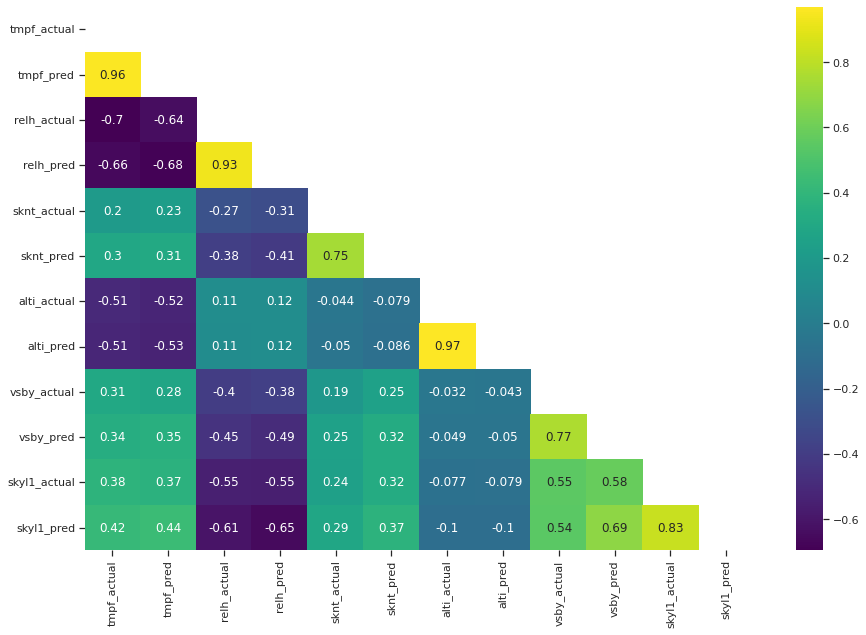

In [351]:
plt.figure(figsize=(15,10))
matrix = results.corr()
mask = np.triu(np.ones_like(matrix, dtype=bool))
sns.heatmap(matrix, mask=mask, annot=True,cmap='viridis')

* **Air Temperature [°F]**

Text(0, 0.5, 'Frequency')

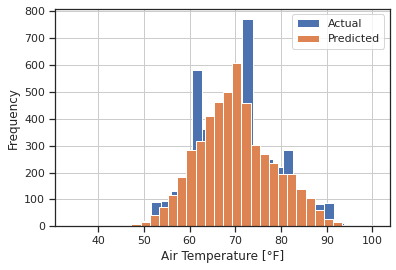

In [352]:
results.tmpf_actual.hist(bins=30)
results.tmpf_pred.hist(bins=30)
plt.legend(('Actual','Predicted'))
plt.xlabel('Air Temperature [°F]')
plt.ylabel('Frequency')

Text(0, 0.5, 'Predicted Air Temperature [°F]')

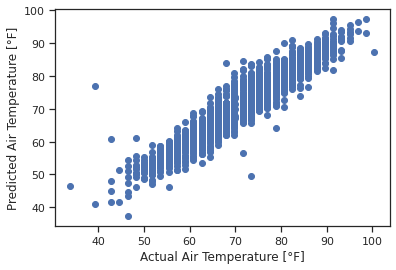

In [353]:
plt.scatter(results.tmpf_actual,results.tmpf_pred, c='b')
plt.xlabel('Actual Air Temperature [°F]')
plt.ylabel('Predicted Air Temperature [°F]')

* **Relative Humidity [%]**

Text(0, 0.5, 'Frequency')

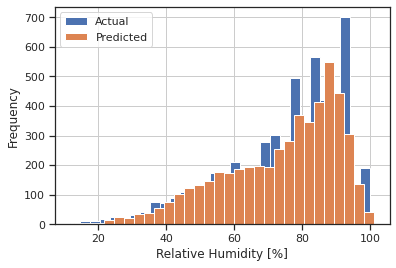

In [354]:
results.relh_actual.hist(bins=30)
results.relh_pred.hist(bins=30)
plt.legend(('Actual','Predicted'))
plt.xlabel('Relative Humidity [%]')
plt.ylabel('Frequency')

Text(0, 0.5, 'Predicted Relative Humidity [%]')

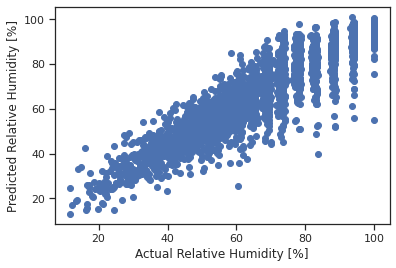

In [355]:
plt.scatter(results.relh_actual,results.relh_pred, c='b')
plt.xlabel('Actual Relative Humidity [%]')
plt.ylabel('Predicted Relative Humidity [%]')

* **Wind Speed [knots]**

Text(0, 0.5, 'Frequency')

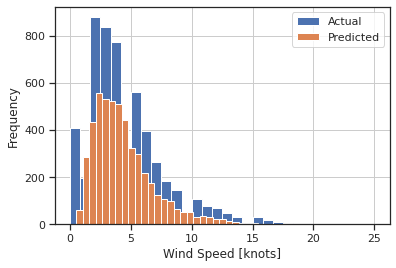

In [356]:
results.sknt_actual.hist(bins=30)
results.sknt_pred.hist(bins=30)
plt.legend(('Actual','Predicted'))
plt.xlabel('Wind Speed [knots]')
plt.ylabel('Frequency')

Text(0, 0.5, 'Predicted Wind Speed [knots]')

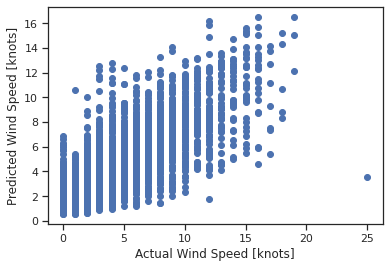

In [357]:
plt.scatter(results.sknt_actual,results.sknt_pred, c='b')
plt.xlabel('Actual Wind Speed [knots]')
plt.ylabel('Predicted Wind Speed [knots]')

* **Pressure altimeter [inches]**

Text(0, 0.5, 'Frequency')

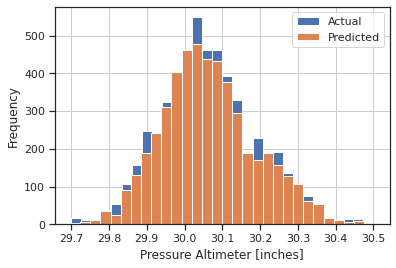

In [358]:
results.alti_actual.hist(bins=30)
results.alti_pred.hist(bins=30)
plt.legend(('Actual','Predicted'))
plt.xlabel('Pressure Altimeter [inches]')
plt.ylabel('Frequency')

Text(0, 0.5, 'Predicted Pressure Altimeter [inches]')

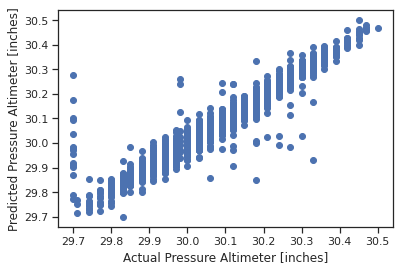

In [359]:
plt.scatter(results.alti_actual,results.alti_pred, c='b')
plt.xlabel('Actual Pressure Altimeter [inches]')
plt.ylabel('Predicted Pressure Altimeter [inches]')

* **Visibility [miles]**

Text(0, 0.5, 'Frequency')

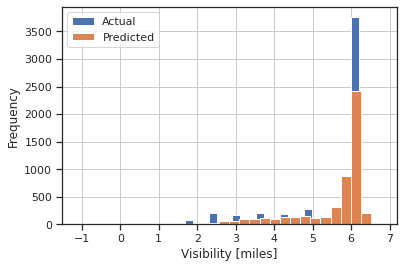

In [360]:
results.vsby_actual.hist(bins=30)
results.vsby_pred.hist(bins=30)
plt.legend(('Actual','Predicted'))
plt.xlabel('Visibility [miles]')
plt.ylabel('Frequency')

Text(0, 0.5, 'Predicted Visibility [miles]')

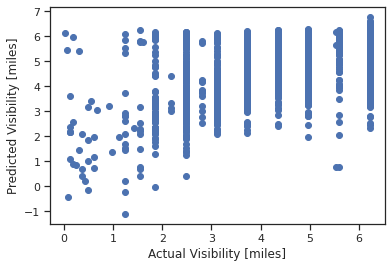

In [361]:
plt.scatter(results.vsby_actual,results.vsby_pred, c='b')
plt.xlabel('Actual Visibility [miles]')
plt.ylabel('Predicted Visibility [miles]')

* **Sky Level 1 Altitude [ft]**

Text(0, 0.5, 'Frequency')

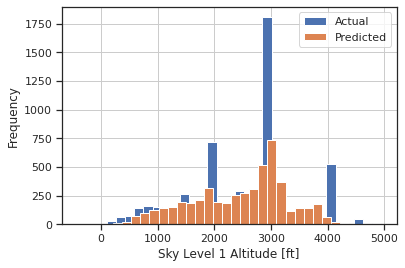

In [362]:
results.skyl1_actual.hist(bins=30)
results.skyl1_pred.hist(bins=30)
plt.legend(('Actual','Predicted'))
plt.xlabel('Sky Level 1 Altitude [ft]')
plt.ylabel('Frequency')

Text(0, 0.5, 'Predicted Sky Level 1 Altitude [ft]')

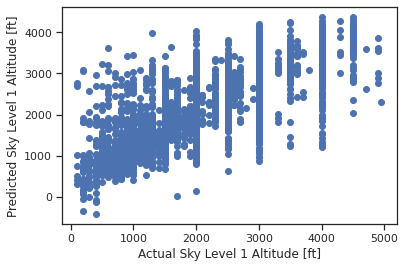

In [363]:
plt.scatter(results.skyl1_actual,results.skyl1_pred, c='b')
plt.xlabel('Actual Sky Level 1 Altitude [ft]')
plt.ylabel('Predicted Sky Level 1 Altitude [ft]')

#### (viii) Residuals

* **Residuals DataFrame**

In [364]:
residuals = pd.DataFrame({'residuals_tmpf':results.tmpf_pred - results.tmpf_actual,
                                                'residuals_relh':results.relh_pred - results.relh_actual,
                                                'residuals_sknt':results.sknt_pred - results.sknt_actual,
                                                'residuals_alti':results.alti_pred - results.alti_actual,
                                                'residuals_vsby':results.vsby_pred - results.vsby_actual,
                                                'residuals_skyl1':results.skyl1_pred - results.skyl1_actual,
                                              })
residuals

,residuals_tmpf,residuals_relh,residuals_sknt,residuals_alti,residuals_vsby,residuals_skyl1
19971,0.399489,-1.726891,-1.304554,0.030322,-0.526217,-530.025962
20809,0.907458,6.677762,-3.710134,0.009839,-0.277226,-46.459348
11000,-0.062341,-1.723705,-3.046100,0.000947,1.040534,-339.198657
11726,0.702703,1.743244,-0.582076,0.010313,0.018147,126.764170
19373,0.797996,-0.592563,4.464529,0.005106,-0.157973,-26.874746
...,...,...,...,...,...,...
39061,-0.301625,-0.438498,1.106484,-0.023066,-0.315848,235.252899
35438,0.876348,-6.293321,-3.349897,0.013623,0.014820,-832.738146
25635,-0.013722,-1.036531,-1.889621,0.033677,-1.640511,-1692.523841
34674,-3.222916,6.281721,7.152418,-0.015573,-0.320989,401.424543


* **Error Distribution by Feature**

Text(0.5, 0, 'Value')

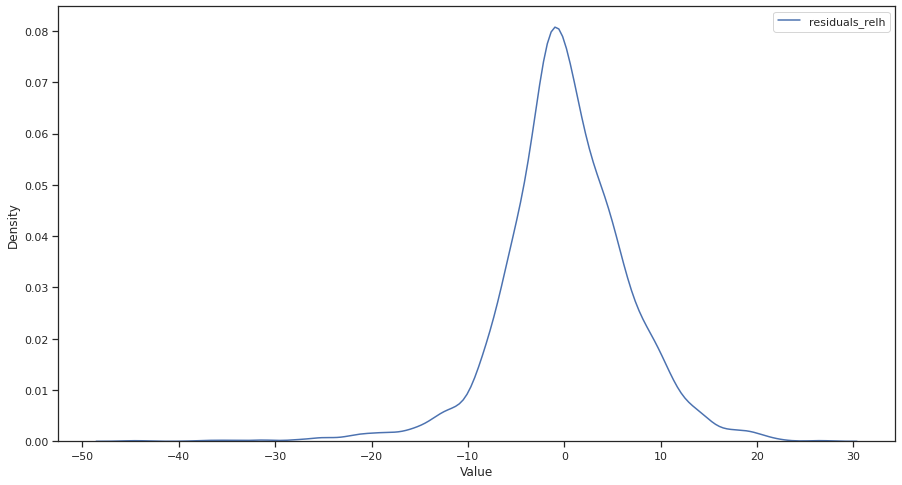

In [365]:
plt.figure(figsize=(15,8))
sns.distplot(residuals.residuals_relh,hist=False,bins=50,)
plt.legend(['residuals_relh'])
plt.xlabel('Value')

Text(0.5, 0, 'Value')

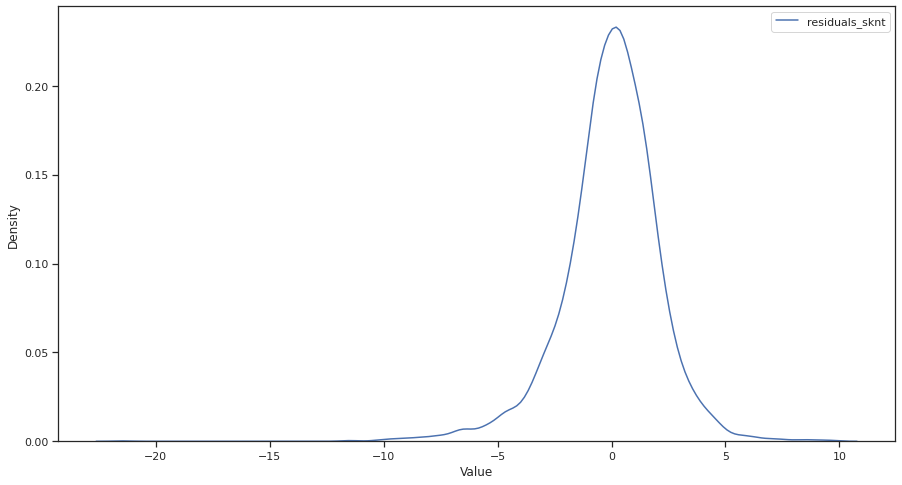

In [366]:
plt.figure(figsize=(15,8))
sns.distplot(residuals.residuals_sknt,hist=False,bins=50,)
plt.legend(['residuals_sknt'])
plt.xlabel('Value')

Text(0.5, 0, 'Value')

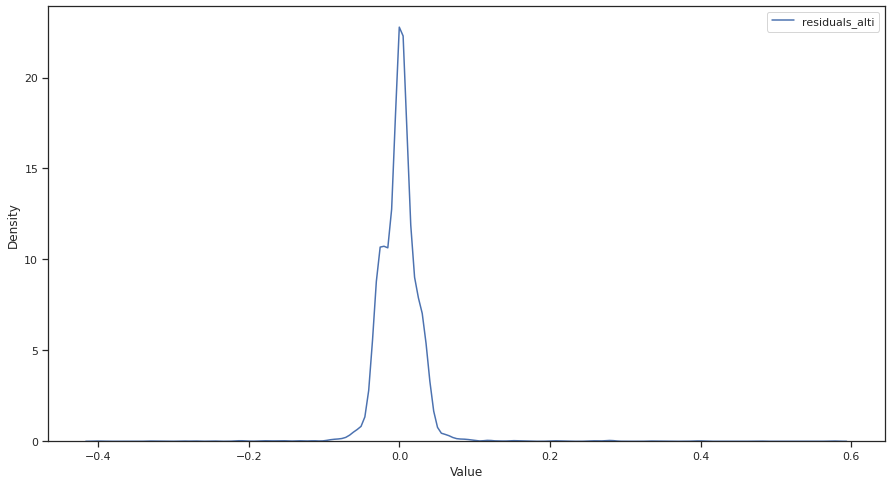

In [367]:
plt.figure(figsize=(15,8))
sns.distplot(residuals.residuals_alti,hist=False,bins=50,)
plt.legend(['residuals_alti'])
plt.xlabel('Value')

Text(0.5, 0, 'Value')

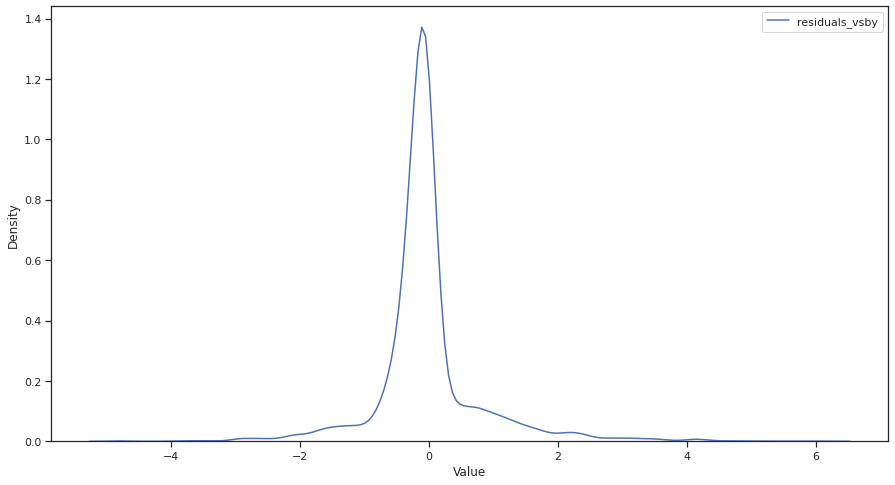

In [368]:
plt.figure(figsize=(15,8))
sns.distplot(residuals.residuals_vsby,hist=False,bins=50,)
plt.legend(['residuals_vsby'])
plt.xlabel('Value')

Text(0.5, 0, 'Value')

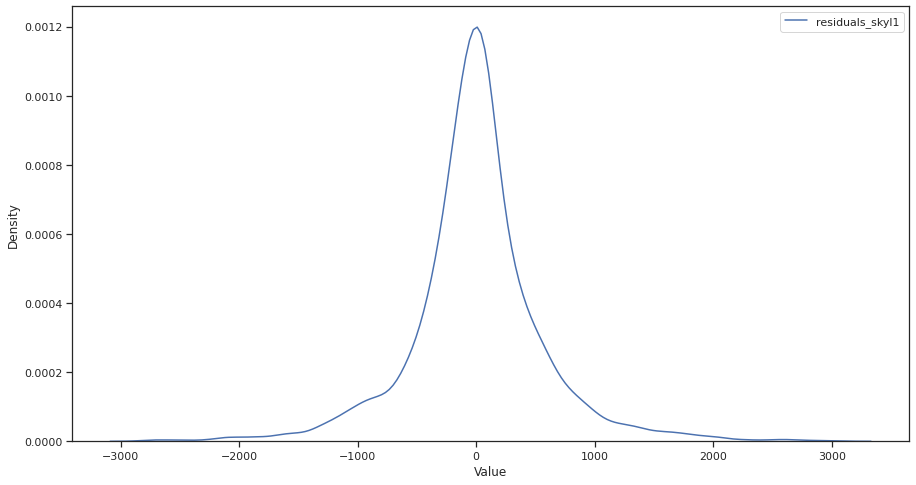

In [369]:
plt.figure(figsize=(15,8))
sns.distplot(residuals.residuals_skyl1,hist=False,bins=50)
plt.legend(['residuals_skyl1'])
plt.xlabel('Value')

#### (ix) Exporting the Model

* **Exporting**

In [410]:
import joblib
filename = 'PredictiveModel_SBSJ.joblib'
joblib.dump(reg_model, filename)

['PredictiveModel_SBSJ.joblib']

* **Loading**

In [411]:
filename = 'PredictiveModel_SBSJ.joblib'
loaded_model = joblib.load(filename)
loaded_model

MultiOutputRegressor(estimator=GradientBoostingRegressor(max_leaf_nodes=10,
                                                         min_impurity_decrease=0,
                                                         min_samples_leaf=2,
                                                         n_estimators=700))

In [412]:
# Example of data to take as input to the model
X.iloc[5]

tmpf                      71.60
dwpf                      69.80
relh                      94.06
drct                      60.00
sknt                       3.00
alti                      30.03
vsby                       6.21
skyl1                   3000.00
feel                      72.88
skyc1_BKN                  0.00
skyc1_FEW                  1.00
skyc1_NSC                  0.00
skyc1_OVC                  0.00
skyc1_SCT                  0.00
skyc1_VV                   0.00
month_Apr                  0.00
month_Aug                  0.00
month_Dec                  0.00
month_Feb                  0.00
month_Jan                  1.00
month_Jul                  0.00
month_Jun                  0.00
month_Mar                  0.00
month_May                  0.00
month_Nov                  0.00
month_Oct                  0.00
month_Sep                  0.00
dayofweek_flag_Fri         0.00
dayofweek_flag_Mon         0.00
dayofweek_flag_Sat         1.00
dayofweek_flag_Sun         0.00
dayofwee

In [413]:
X.iloc[[5]].values #input values

array([[7.160e+01, 6.980e+01, 9.406e+01, 6.000e+01, 3.000e+00, 3.003e+01,
        6.210e+00, 3.000e+03, 7.288e+01, 0.000e+00, 1.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 0.000e+00]])

In [414]:
model_input = X.iloc[[5]].values
model_output = loaded_model.predict(model_input)
model_output

X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names
X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names
X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names
X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names
X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names
X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names


array([[7.22343295e+01, 9.20943220e+01, 2.71858182e+00, 3.00303889e+01,
        6.14545200e+00, 2.76919196e+03]])

In [415]:
pd.DataFrame(model_output,columns=list(y.columns))

,tmpf,relh,sknt,alti,vsby,skyl1
0,72.234329,92.094322,2.718582,30.030389,6.145452,2769.191958
